In [1]:
from __future__ import print_function
from matplotlib import pyplot as plt
plt.switch_backend('agg')
%matplotlib inline
import numpy as np
#import pandas as pd

from IPython.display import display, HTML
import tensorflow as tf
#import numpy as np
#import pandas as pd
#import random as ran
import h5py

import pandas as pd


In [36]:
def Overlap_calc(hp,sp,psd):
    f_low = 20
    m, i = match(hp, sp, psd=psd, low_frequency_cutoff=f_low)
    o = overlap(hp, sp, psd=psd, low_frequency_cutoff=f_low)
    return m


In [3]:
def _preprocess_data(data, num, samples):
    new_array = []
    for i in range(num):
        dataset = data[i]
        if((dataset.max() != 0.0) and (dataset.min() != 0.0)):
            maximum = np.max(dataset)
            minimum = np.abs(np.min(dataset))
            for j in range(samples):
                if(dataset[j] > 0):
                    dataset[j] = dataset[j]/maximum
                else:
                    dataset[j] = dataset[j]/minimum
        new_array.append(dataset)
    return new_array, maximum, minimum


In [4]:
# Split a univariate sequence into samples
#def split_sequence(sequence_noisy,sequence_pure,n_steps):
def split_sequence(sequence_noisy,n_steps):
    X = [] 
#    y = []
    for i in range(len(sequence_noisy)):
    # find the end of this pattern
        end_ix = i + n_steps
        # check if we are beyond the sequence
        if end_ix > len(sequence_noisy)-1:
            break
        # gather input and output parts of the pattern
        seq_x = sequence_noisy[i:end_ix] 
#        seq_y = sequence_pure[end_ix]
        X.append(seq_x)
#        y.append(seq_y)
#    return array(X), array(y)
    return np.array(X)
    
    
#def reshape_sequences(self, num, data_noisy, data_pure):
def reshape_sequences(num, data_noisy):
    n_steps = 15
    arr_noisy = []
#    arr_pure = []
        
    for i in range(num):
        X_noisy = data_noisy[i]
#        X_pure = data_pure[i]
        X_noisy = np.pad(X_noisy, (n_steps, n_steps), 'constant', constant_values=(0, 0))
#        X_pure = np.pad(X_pure, (n_steps, n_steps), 'constant', constant_values=(0, 0))
        # split into samples
#        X, y = self.split_sequence(X_noisy, X_pure, n_steps)
        X = split_sequence(X_noisy, n_steps)
        arr_noisy.append(X)
#        arr_pure.append(y)
    
    arr_noisy = np.asarray(arr_noisy)
#    arr_pure = np.asarray(arr_pure)
        
#    return arr_noisy, arr_pure
    return arr_noisy


In [5]:
class FractalTanimotoLoss(tf.keras.losses.Loss):
        def __init__(lr, base_lr=2e-3, depth=0, smooth=1e-6, **kwargs):
            depth = depth
            learning_rate = lr
            base_lr = base_lr
            smooth = smooth
            super().__init__(**kwargs)
    
        def inner_prod(self, y, x):
            prod = y*x
            prod = K.sum(prod, axis=1)
        
            return prod
    
        def tnmt_base(x, y, scale):

            tpl  = inner_prod(y,x)
            tpp  = inner_prod(y,y)
            tll  = inner_prod(x,x)


            num = tpl + self.smooth
            denum = 0.0
            result = 0.0
            for d in range(depth):
                a = 2.**d
                b = -(2.*a-1.)

                denum = denum + tf.math.reciprocal( a*(tpp+tll) + b *tpl + smooth)
                
            result =  num * denum * scale
            
            return  result*scale
        
        def call(y_true, y_pred):
            
            if(learning_rate < base_lr):
                depth = depth + 5
                
            depth = depth+1
            scale = 1./len(range(depth))
            
            l1 = K.mean(K.square(y_pred - y_true),axis=-1)
            result = tnmt_base(y_true, y_pred, scale)
        
            return  l1 - 0.01*result
        
        def get_config(self):
            base_config = super().get_config()
            return {**base_config, "depth": depth}   
    

In [6]:
f1 = h5py.File("/fred/oz016/Chayan/BBH_sample_files/O3b_test_IMRPhenomXPHM_SNR-8to10_mchirp_all_500.hdf", "r")
strain = f1['injection_samples']['l1_strain'][()]
noise = f1['noise_samples']['l1_strain'][()]

pure_signal = f1['injection_parameters']['l1_signal_whitened'][()]
pure_noise = f1['noise_parameters']['l1_signal_whitened'][()]


In [7]:
def _preprocess_data(data, num, samples):
    new_array = []
    for i in range(num):
        dataset = data[i]
        if((dataset.max() != 0.0) and (dataset.min() != 0.0)):
            maximum = np.max(dataset)
            minimum = np.abs(np.min(dataset))
            for j in range(samples):
                if(dataset[j] > 0):
                    dataset[j] = dataset[j]/maximum
                else:
                    dataset[j] = dataset[j]/minimum
        new_array.append(dataset)
    return new_array, maximum, minimum


In [8]:
strain, maximum, minimum = _preprocess_data(strain, 25, 2048)
strain = np.array(strain)
strain.shape

noise, maximum, minimum = _preprocess_data(noise, 5, 2048)
noise = np.array(noise)
noise.shape


(5, 2048)

In [9]:
X_test_strain = reshape_sequences(25, strain)
X_test_noise = reshape_sequences(5, noise)

X_test_pure_signal = reshape_sequences(25, pure_signal)
X_test_pure_noise = reshape_sequences(5, pure_noise)


In [10]:
# Reshape arrays to fit into Keras model
X_test_strain = X_test_strain[:,:,:,None]
print('x_test_strain shape:', X_test_strain.shape)
X_test_strain = X_test_strain.astype("float32")

X_test_noise = X_test_noise[:,:,:,None]
print('x_test_noise shape:', X_test_noise.shape)
X_test_noise = X_test_noise.astype("float32")

X_test_pure_signal = X_test_pure_signal[:,:,:,None]
print('x_test_pure_signal shape:', X_test_pure_signal.shape)
X_test_pure_signal = X_test_pure_signal.astype("float32")

X_test_pure_noise = X_test_pure_noise[:,:,:,None]
print('x_test_pure_noise shape:', X_test_pure_noise.shape)
X_test_pure_noise = X_test_pure_noise.astype("float32")


x_test_strain shape: (25, 2063, 15, 1)
x_test_noise shape: (5, 2063, 15, 1)
x_test_pure_signal shape: (25, 2063, 15, 1)
x_test_pure_noise shape: (5, 2063, 15, 1)


In [11]:
class TimeDistributedMultiHeadAttention(tf.keras.layers.Layer):
        def __init__(self, num_heads, key_dim, **kwargs):
            super().__init__(**kwargs)
            self.num_heads = num_heads
            self.key_dim = key_dim
            self.multi_head_attention = tf.keras.layers.MultiHeadAttention(num_heads=num_heads, key_dim=key_dim)

        def call(self, inputs):
            # Use tf.shape for dynamic shape and inputs.shape for static shape
            shape = tf.shape(inputs)
            static_shape = inputs.shape
            batch_size, num_subsequences, subsequence_length = shape[0], static_shape[1], static_shape[2]
            features = static_shape[3]

            reshaped_inputs = tf.reshape(inputs, [-1, subsequence_length, features])

            # Apply multi-head attention to each subsequence individually
            attention_output = self.multi_head_attention(reshaped_inputs, reshaped_inputs)

            # Reshape the output back to the original input shape
            output_shape = [-1, num_subsequences, subsequence_length, features]
            return tf.reshape(attention_output, output_shape)

        def compute_output_shape(self, input_shape):
            return input_shape
        
        def get_config(self):
            config = super().get_config()
            config.update({
                'num_heads': self.num_heads,
                'key_dim': self.key_dim
            })
            return config


In [12]:
class AttentionLayer(tf.keras.layers.Layer):
        def __init__(self, **kwargs):
            super().__init__(**kwargs)

        def build(self, input_shape):
            self.W = self.add_weight(name='attention_weight',
                                 shape=(input_shape[-1], 1),
                                 initializer='random_normal',
                                 trainable=True)
            self.b = self.add_weight(name='attention_bias',
                                 shape=(input_shape[1], 1),
                                 initializer='zeros',
                                 trainable=True)
            super().build(input_shape)
        
        def call(self, x):
            e = K.tanh(K.dot(x, self.W) + self.b)
            a = K.softmax(e, axis=1)
            output = x * a
            return output
        
        def compute_output_shape(self,input_shape):
            return (input_shape[0],input_shape[-1])

        def get_config(self):
            return super().get_config()
    

In [13]:
#from keras.models import load_model
from tensorflow.keras import backend as K

#model = tf.keras.models.load_model('/fred/oz016/Chayan/GW-Denoiser/model/model_IMRPhenomXPHM_O3b_noise_old_model_4_timesteps_mchirp_all.h5', custom_objects={'FractalTanimotoLoss': FractalTanimotoLoss, 'AttentionLayer': AttentionLayer})

#model = tf.keras.models.load_model('/fred/oz016/Chayan/GW-Denoiser/model/model_IMRPhenomXPHM_O3b_noise_4_timesteps_old_model_new_training_data.h5', custom_objects={'FractalTanimotoLoss': FractalTanimotoLoss, 'AttentionLayer': AttentionLayer})

#model = tf.keras.models.load_model('/fred/oz016/Chayan/GW-Denoiser/model/model_IMRPhenomXPHM_O3b_noise_4_timesteps_new.h5', custom_objects={'FractalTanimotoLoss': FractalTanimotoLoss, 'AttentionLayer': AttentionLayer})

#model = tf.keras.models.load_model('/fred/oz016/Chayan/GW-Denoiser/model/trained_model_test_IMBH_HM_O3b_noise_mass_corrected.h5', custom_objects={'FractalTanimotoLoss': FractalTanimotoLoss})

#model = tf.keras.models.load_model('/fred/oz016/Chayan/GW-Denoiser/model/model_IMRPhenomXPHM_O3b_noise_10_timesteps_larger_model_new_training_data.h5', custom_objects={'FractalTanimotoLoss': FractalTanimotoLoss, 'AttentionLayer': AttentionLayer})

#model1 = tf.keras.models.load_model('/fred/oz016/Chayan/GW-Denoiser/model/model_IMRPhenomXPHM_O3b_noise_10_timesteps_attention_30Hz.h5', custom_objects={'FractalTanimotoLoss': FractalTanimotoLoss, 'AttentionLayer': AttentionLayer})

model10 = tf.keras.models.load_model('/fred/oz016/Chayan/GW-Denoiser/model/model_IMRPhenomXPHM_O3b_noise_10_timesteps_30Hz_mse_loss_larger_model_encoder_attention.h5', custom_objects={'FractalTanimotoLoss': FractalTanimotoLoss, 'TimeDistributedMultiHeadAttention': TimeDistributedMultiHeadAttention})

model11 = tf.keras.models.load_model('/fred/oz016/Chayan/GW-Denoiser/model/model_IMRPhenomXPHM_O3b_noise_10_timesteps_30Hz_mse_loss_larger_model_encoder_attention_1.h5', custom_objects={'FractalTanimotoLoss': FractalTanimotoLoss, 'TimeDistributedMultiHeadAttention': TimeDistributedMultiHeadAttention})


#model = tf.keras.models.load_model('/fred/oz016/Chayan/GW-Denoiser/model/model_IMRPhenomXPHM_O3b_noise_10_timesteps_30Hz_mse_loss_larger_model_encoder_attention.h5', custom_objects={'FractalTanimotoLoss': FractalTanimotoLoss, 'TimeDistributedMultiHeadAttention': TimeDistributedMultiHeadAttention})

# load model
#model = tf.keras.models.load_model('/fred/oz016/Chayan/GW-Denoiser/model/model_IMRPhenomXPHM_O3b_noise_dilated_CNN_25_timesteps.h5', custom_objects={'FractalTanimotoLoss': FractalTanimotoLoss})

# summarize model.
#model10.summary()


In [17]:
decoded_signals1 = model11.predict(X_test_strain, batch_size=25)
decoded_signals_pure_noise1 = model11.predict(X_test_noise, batch_size=25)

decoded_signals2 = model10.predict(X_test_strain, batch_size=25)
decoded_signals_pure_noise2 = model10.predict(X_test_noise, batch_size=25)


In [18]:
from pycbc.filter import match, overlap
from pycbc.psd import aLIGOZeroDetHighPower
from pycbc.types.timeseries import TimeSeries, FrequencySeries
import matplotlib.pyplot as plt

def plot_reconstructed(decoded_signals, pure_signals, strain, m1, m2, snr, psd):
    
    time_buffer = 1
    length_signal = len(decoded_signals)

    f_low = 18
    sample_rate = 2048

    # Length of corresponding time series and frequency series
    tlen = sample_rate * time_buffer
    flen = tlen // 2 + 1

    delta_f = 1.0 / time_buffer
#    psd = aLIGOZeroDetHighPower(flen, delta_f, f_low)
    psd = FrequencySeries(psd, delta_f=delta_f)
    
    X_test_pure_ts = TimeSeries(pure_signals.squeeze(), delta_t = 1.0/2048)
    decoded_signals_ts = TimeSeries(decoded_signals.squeeze(), delta_t = 1.0/2048)

    X_test_pure_ts.resize(tlen)
    decoded_signals_ts.resize(tlen)

    if(X_test_pure_ts.max() != 0.0):
        m = Overlap_calc(X_test_pure_ts,decoded_signals_ts,psd)
        overlap = m
    else:
        m = 1
        overlap = m
    
    fig = plt.figure(figsize=(10,5))

    time = np.linspace(-0.80, 0.20, length_signal)

    plt.subplots_adjust(left=0.1,
                    bottom=0.1, 
                    right=0.9, 
                    top=0.9, 
                    wspace=0.4, 
                    hspace=0.4)

    signal_axes = fig.add_subplot(211)
#    signal_axes.set_ylim(-1.1, 1.1)
    signal_axes.set_title('Mass1 = {m1}, Mass2 = {m2}, S/N = {snr}, Overlap = {m}'.format(m1=np.round(m1,2), m2=np.round(m2,2), snr=np.round(snr,2), m=np.round(m,2)))
    signal_axes.plot(time,strain.squeeze()/0.5, linewidth=1.2, label ='Whitened Livingston strain', alpha=0.5)
    signal_axes.plot(time,pure_signals.squeeze(), linewidth=1.2, label ='Pure Livingston signal')
    signal_axes.plot(time,decoded_signals.squeeze(), linewidth=1.2, label ='Denoised Livingston signal', c='red', linestyle='dashed')
    signal_axes.set_ylabel('Rescaled Amplitudes')
    signal_axes.legend()
    
    return overlap

#    plt.savefig('IMBH_test/IMRPhenomXPHM_O3b_signal+noise/SNR-8to9/Plot_m1-'+str(int(m1))+'_m2-'+str(int(m2))+'_snr-'+str(int(snr))+'.png', bbox_inches='tight', facecolor='w', transparent=False, dpi=200)


# SNR - 8 to 10 (10 timesteps model)

<ipython-input-18-f5335e0d8b93>:35: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=(10,5))


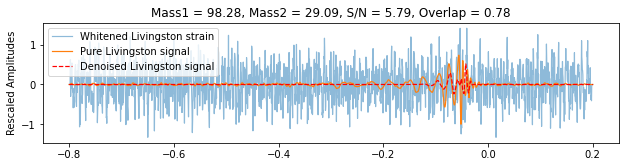

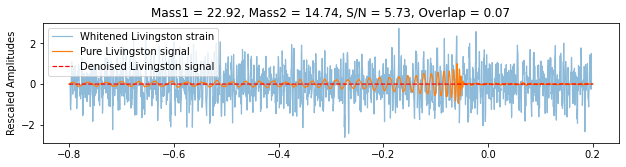

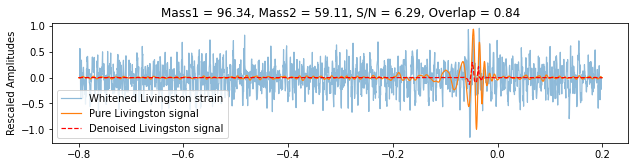

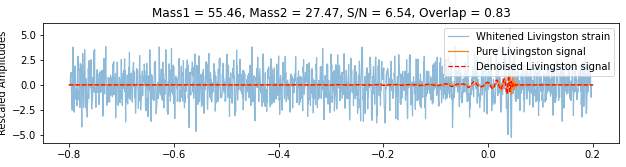

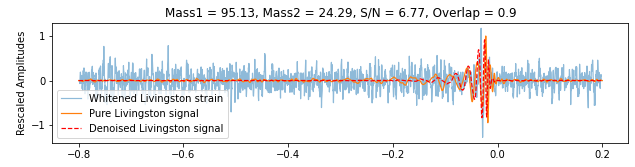

...

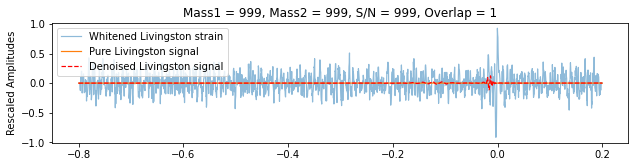

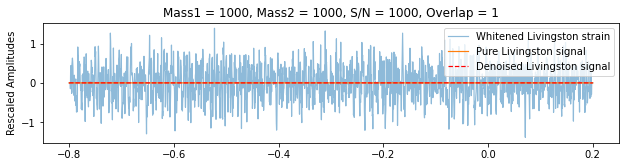

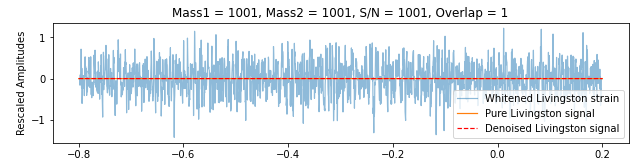

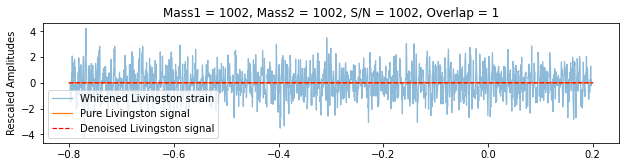

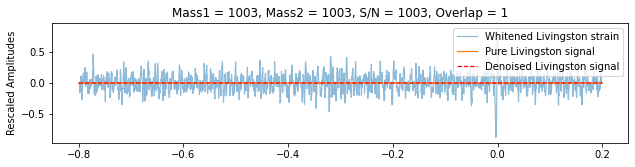

In [20]:
overlaps_10 = []

for i in range(25):
    pure_signals = np.pad(f1['injection_parameters']['l1_signal_whitened'][i].astype(np.float64), (5,5), constant_values=(0,0))   
    strain = np.pad(f1['injection_samples']['l1_strain'][i].astype(np.float64), (5,5), constant_values=(0,0))
    psd = f1['injection_parameters']['psd_noise_l1'][i].astype(np.float64)
    
    m1 = f1['injection_parameters']['mass1'][i]
    m2 = f1['injection_parameters']['mass2'][i]
    snr = f1['injection_parameters']['l1_snr'][i]*f1['injection_parameters']['scale_factor'][i]
    
    overlaps_10.append(plot_reconstructed(decoded_signals1[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr, psd))


for i in range(5):
    
    pure_signals = np.pad(f1['noise_parameters']['l1_signal_whitened'][i].astype(np.float64), (5,5), constant_values=(0,0))     
    strain = np.pad(f1['noise_samples']['l1_strain'][i].astype(np.float64), (5,5), constant_values=(0,0))
    
    m1 = 999 + i
    m2 = 999 + i
    snr = 999 + i
        
    plot_reconstructed(decoded_signals_pure_noise1[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr, psd)
    

# SNR - 8 to 10 (10 timesteps model - more LSTM layers + attention)

<ipython-input-15-f5335e0d8b93>:35: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(10,5))


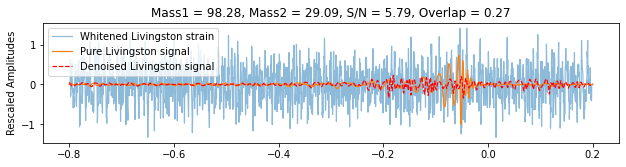

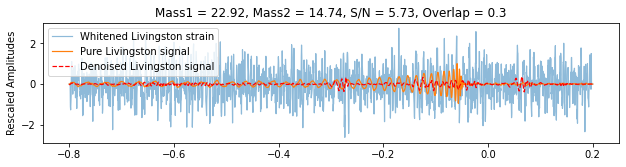

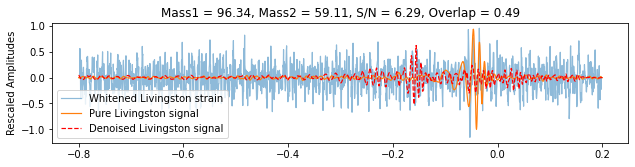

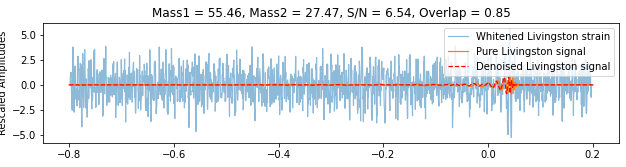

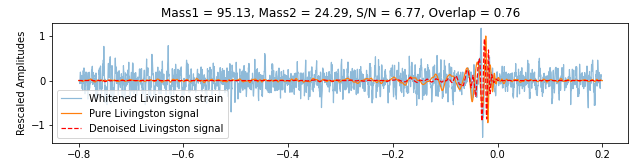

...

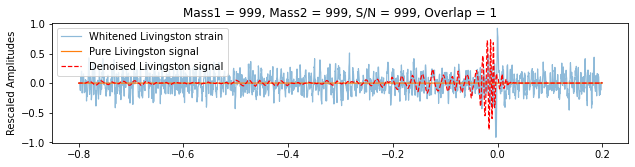

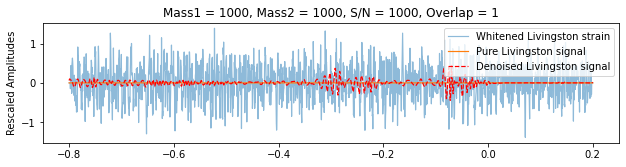

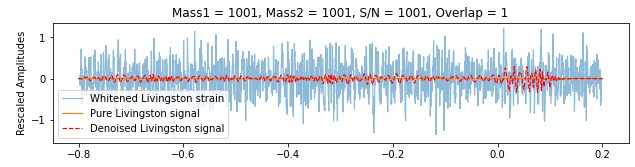

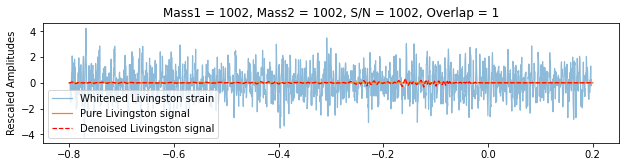

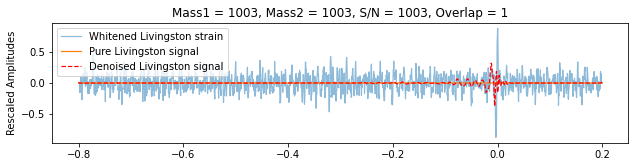

In [16]:
overlaps_10 = []

for i in range(25):
    pure_signals = np.pad(f1['injection_parameters']['l1_signal_whitened'][i].astype(np.float64), (5,5), constant_values=(0,0))   
    strain = np.pad(f1['injection_samples']['l1_strain'][i].astype(np.float64), (5,5), constant_values=(0,0))
    psd = f1['injection_parameters']['psd_noise_l1'][i].astype(np.float64)
    
    m1 = f1['injection_parameters']['mass1'][i]
    m2 = f1['injection_parameters']['mass2'][i]
    snr = f1['injection_parameters']['l1_snr'][i]*f1['injection_parameters']['scale_factor'][i]
    
    overlaps_10.append(plot_reconstructed(decoded_signals[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr, psd))


for i in range(5):
    
    pure_signals = np.pad(f1['noise_parameters']['l1_signal_whitened'][i].astype(np.float64), (5,5), constant_values=(0,0))     
    strain = np.pad(f1['noise_samples']['l1_strain'][i].astype(np.float64), (5,5), constant_values=(0,0))
    
    m1 = 999 + i
    m2 = 999 + i
    snr = 999 + i
        
    plot_reconstructed(decoded_signals_pure_noise[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr, psd)
    

# SNR - 8 to 10 (10 timesteps + attention + 30 Hz training)

<ipython-input-16-f5335e0d8b93>:35: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(10,5))


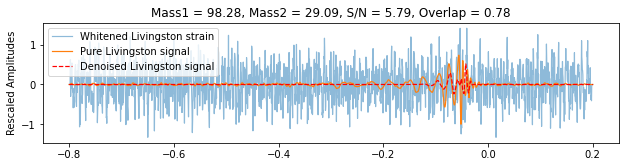

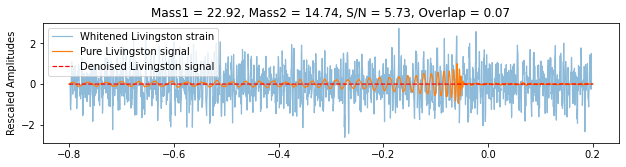

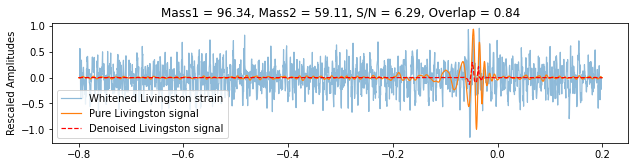

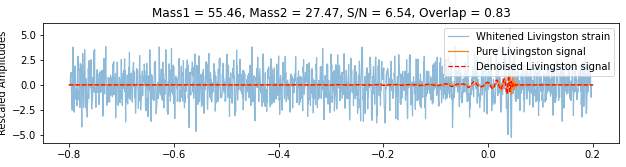

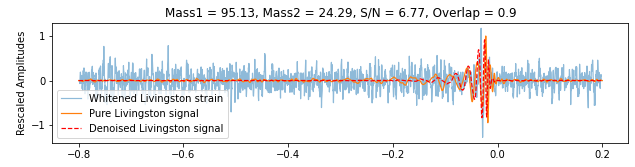

...

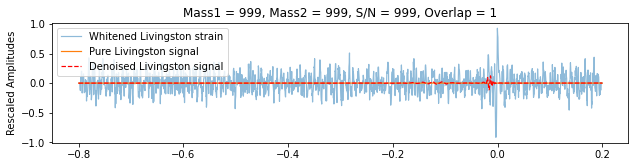

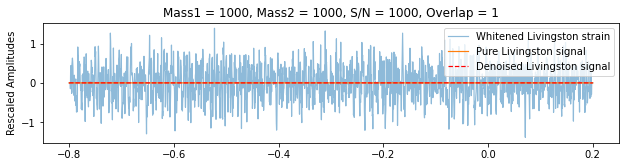

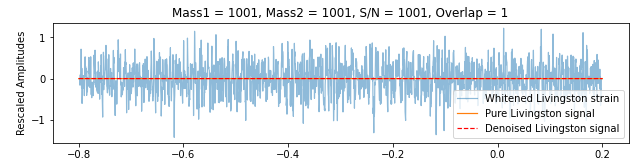

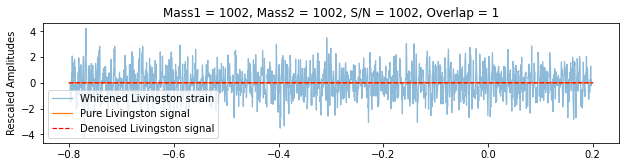

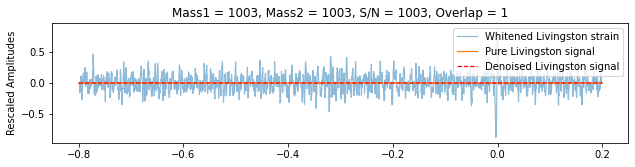

In [17]:
overlaps_10 = []

for i in range(25):
    pure_signals = np.pad(f1['injection_parameters']['l1_signal_whitened'][i].astype(np.float64), (5,5), constant_values=(0,0))   
    strain = np.pad(f1['injection_samples']['l1_strain'][i].astype(np.float64), (5,5), constant_values=(0,0))
    psd = f1['injection_parameters']['psd_noise_l1'][i].astype(np.float64)
    
    m1 = f1['injection_parameters']['mass1'][i]
    m2 = f1['injection_parameters']['mass2'][i]
    snr = f1['injection_parameters']['l1_snr'][i]*f1['injection_parameters']['scale_factor'][i]
    
    overlaps_10.append(plot_reconstructed(decoded_signals[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr, psd))


for i in range(5):
    
    pure_signals = np.pad(f1['noise_parameters']['l1_signal_whitened'][i].astype(np.float64), (5,5), constant_values=(0,0))     
    strain = np.pad(f1['noise_samples']['l1_strain'][i].astype(np.float64), (5,5), constant_values=(0,0))
    
    m1 = 999 + i
    m2 = 999 + i
    snr = 999 + i
        
    plot_reconstructed(decoded_signals_pure_noise[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr, psd)
    

# SNR - 8 to 10 (4 timesteps model)

<ipython-input-16-f5335e0d8b93>:35: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(10,5))


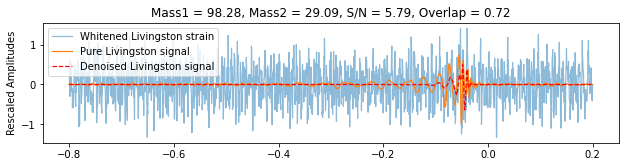

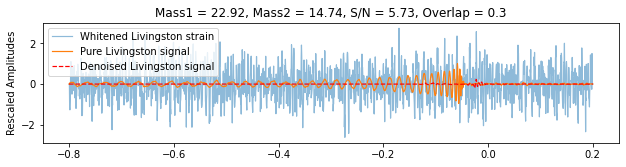

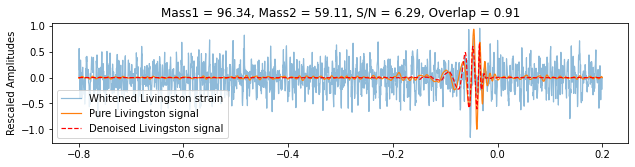

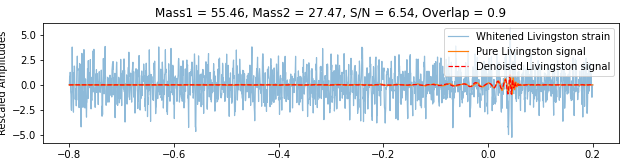

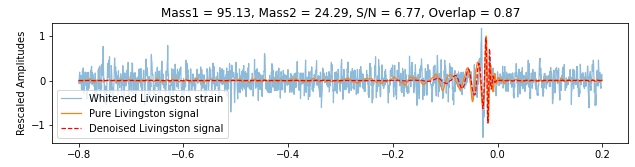

...

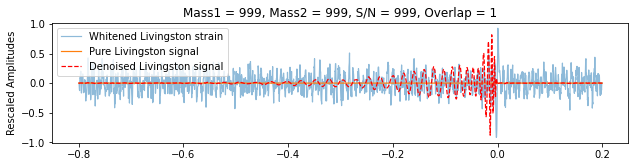

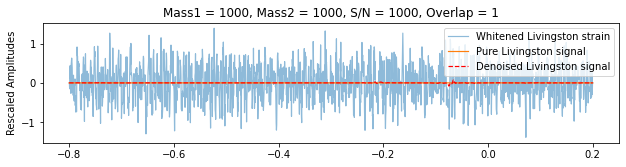

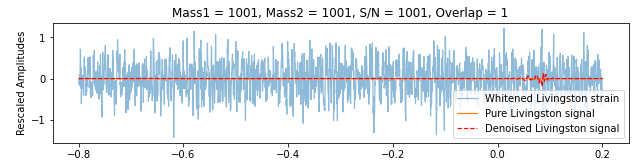

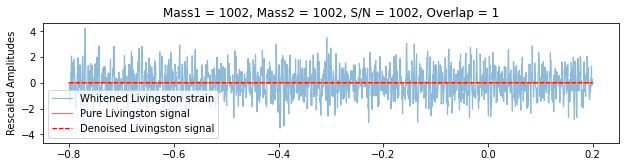

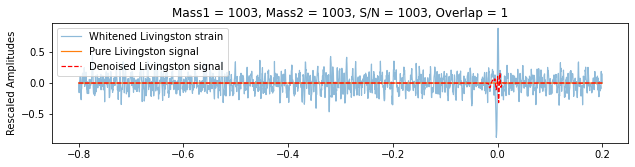

In [17]:
overlaps_10 = []

for i in range(25):
    pure_signals = np.pad(f1['injection_parameters']['l1_signal_whitened'][i].astype(np.float64), (2,2), constant_values=(0,0))   
    strain = np.pad(f1['injection_samples']['l1_strain'][i].astype(np.float64), (2,2), constant_values=(0,0))
    psd = f1['injection_parameters']['psd_noise_l1'][i].astype(np.float64)
    
    m1 = f1['injection_parameters']['mass1'][i]
    m2 = f1['injection_parameters']['mass2'][i]
    snr = f1['injection_parameters']['l1_snr'][i]*f1['injection_parameters']['scale_factor'][i]
    
    overlaps_10.append(plot_reconstructed(decoded_signals[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr, psd))


for i in range(5):
    
    pure_signals = np.pad(f1['noise_parameters']['l1_signal_whitened'][i].astype(np.float64), (2,2), constant_values=(0,0))     
    strain = np.pad(f1['noise_samples']['l1_strain'][i].astype(np.float64), (2,2), constant_values=(0,0))
    
    m1 = 999 + i
    m2 = 999 + i
    snr = 999 + i
        
    plot_reconstructed(decoded_signals_pure_noise[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr, psd)
    

# SNR - 8 to 10 (4 timesteps - new training data)

<ipython-input-14-f5335e0d8b93>:35: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(10,5))


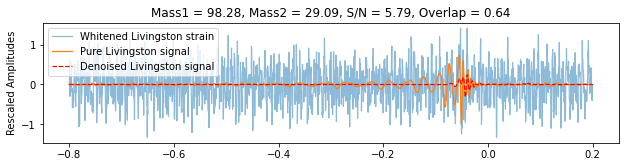

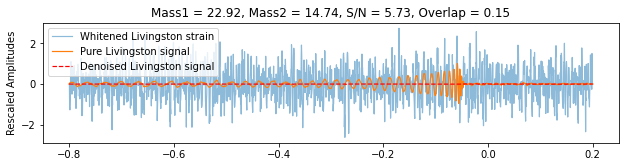

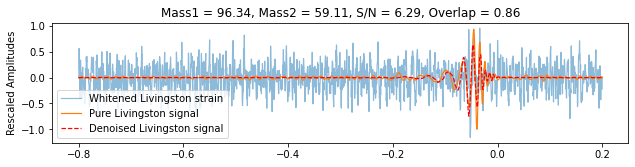

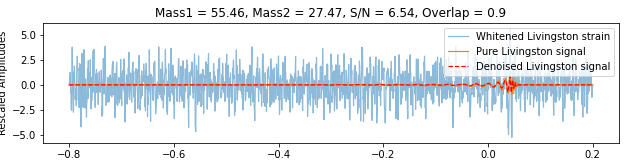

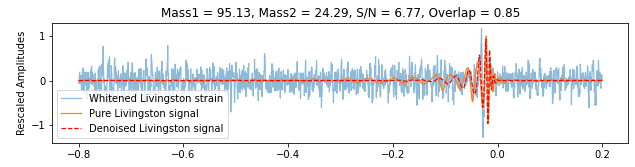

...

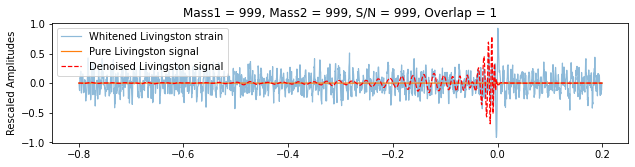

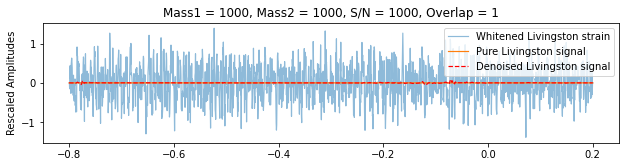

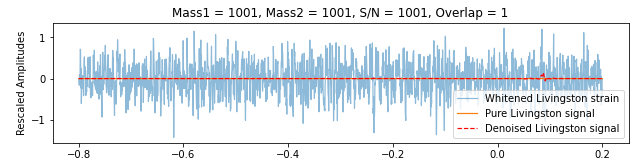

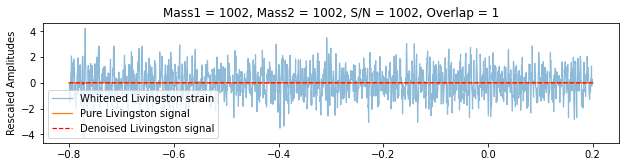

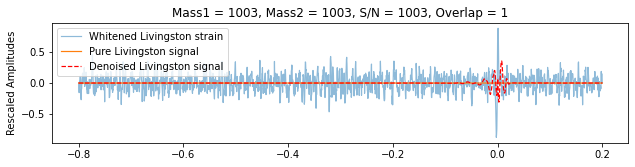

In [15]:
overlaps_10 = []

for i in range(25):
    pure_signals = np.pad(f1['injection_parameters']['l1_signal_whitened'][i].astype(np.float64), (2,2), constant_values=(0,0))   
    strain = np.pad(f1['injection_samples']['l1_strain'][i].astype(np.float64), (2,2), constant_values=(0,0))
    psd = f1['injection_parameters']['psd_noise_l1'][i].astype(np.float64)
    
    m1 = f1['injection_parameters']['mass1'][i]
    m2 = f1['injection_parameters']['mass2'][i]
    snr = f1['injection_parameters']['l1_snr'][i]*f1['injection_parameters']['scale_factor'][i]
    
    overlaps_10.append(plot_reconstructed(decoded_signals[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr, psd))


for i in range(5):
    
    pure_signals = np.pad(f1['noise_parameters']['l1_signal_whitened'][i].astype(np.float64), (2,2), constant_values=(0,0))     
    strain = np.pad(f1['noise_samples']['l1_strain'][i].astype(np.float64), (2,2), constant_values=(0,0))
    
    m1 = 999 + i
    m2 = 999 + i
    snr = 999 + i
        
    plot_reconstructed(decoded_signals_pure_noise[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr, psd)
    

# SNR - 8 to 10 (4 timesteps - more layers + attention)

<ipython-input-14-f5335e0d8b93>:35: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(10,5))


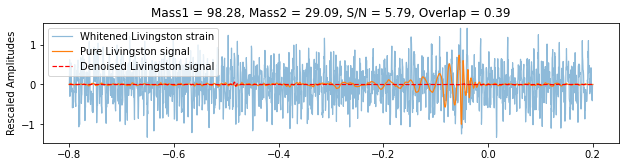

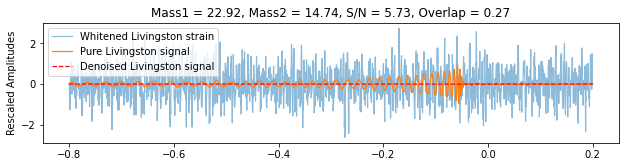

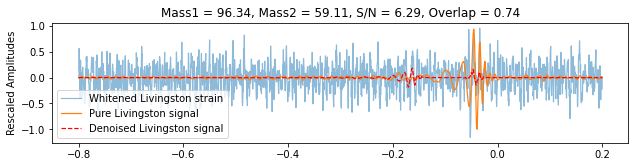

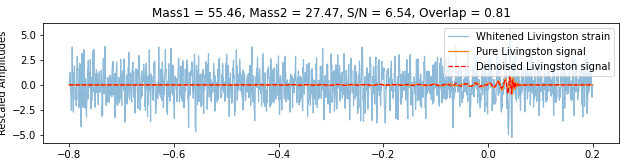

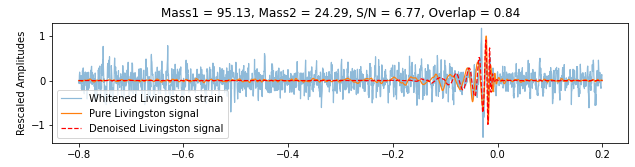

...

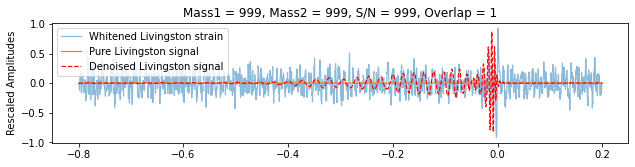

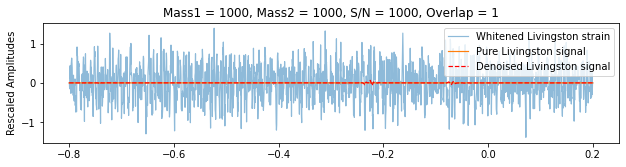

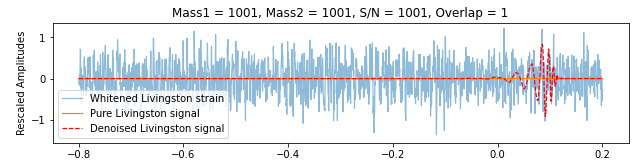

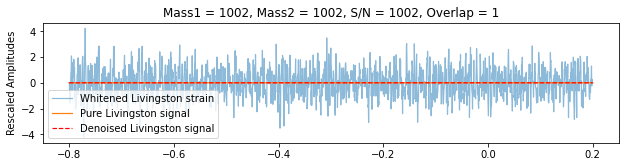

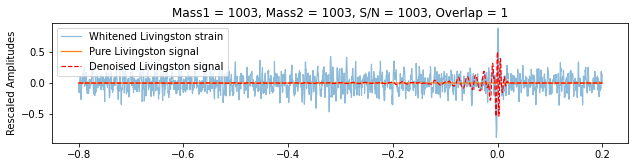

In [15]:
overlaps_10 = []

for i in range(25):
    pure_signals = np.pad(f1['injection_parameters']['l1_signal_whitened'][i].astype(np.float64), (2,2), constant_values=(0,0))   
    strain = np.pad(f1['injection_samples']['l1_strain'][i].astype(np.float64), (2,2), constant_values=(0,0))
    psd = f1['injection_parameters']['psd_noise_l1'][i].astype(np.float64)
    
    m1 = f1['injection_parameters']['mass1'][i]
    m2 = f1['injection_parameters']['mass2'][i]
    snr = f1['injection_parameters']['l1_snr'][i]*f1['injection_parameters']['scale_factor'][i]
    
    overlaps_10.append(plot_reconstructed(decoded_signals[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr, psd))


for i in range(5):
    
    pure_signals = np.pad(f1['noise_parameters']['l1_signal_whitened'][i].astype(np.float64), (2,2), constant_values=(0,0))     
    strain = np.pad(f1['noise_samples']['l1_strain'][i].astype(np.float64), (2,2), constant_values=(0,0))
    
    m1 = 999 + i
    m2 = 999 + i
    snr = 999 + i
        
    plot_reconstructed(decoded_signals_pure_noise[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr, psd)
    

# SNR - 8 to 10 (5 timesteps)

<ipython-input-15-f5335e0d8b93>:35: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(10,5))


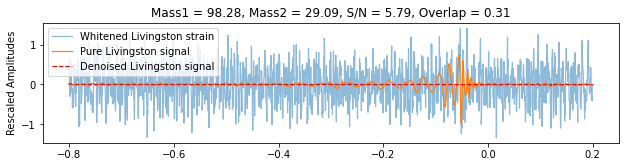

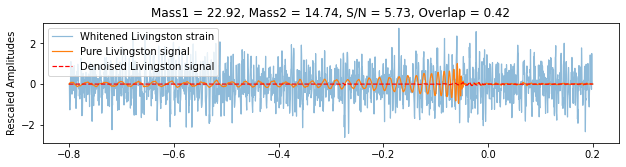

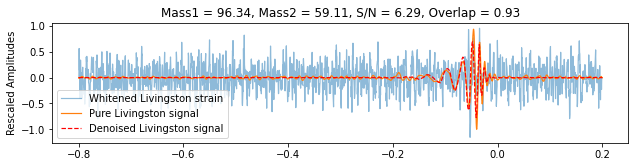

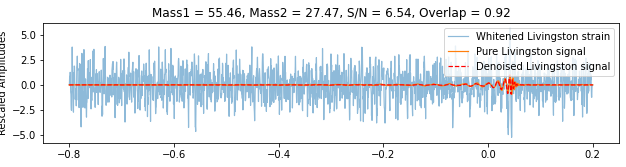

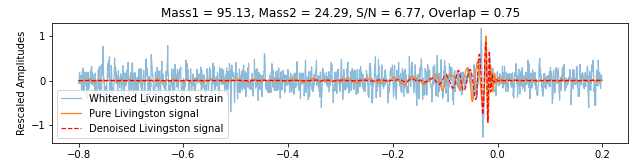

...

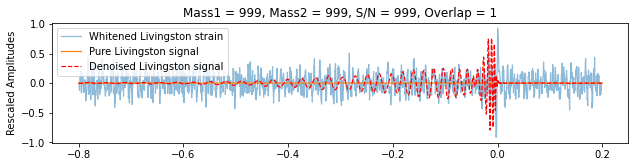

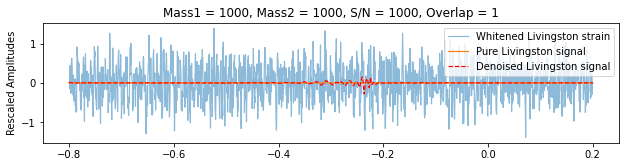

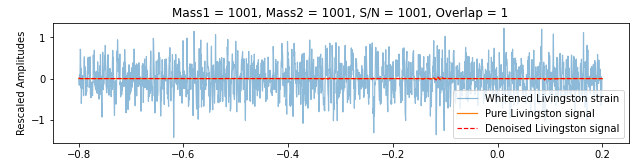

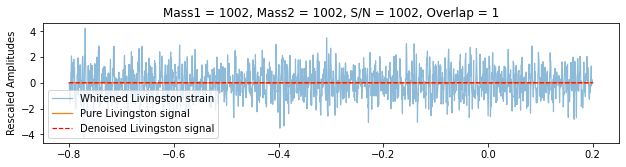

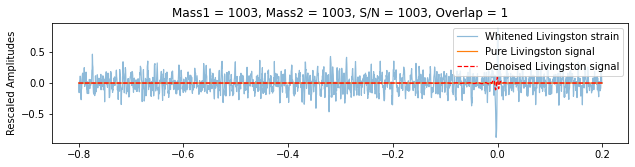

In [17]:
overlaps_10 = []

for i in range(25):
    pure_signals = np.pad(f1['injection_parameters']['l1_signal_whitened'][i].astype(np.float64), (2,3), constant_values=(0,0))   
    strain = np.pad(f1['injection_samples']['l1_strain'][i].astype(np.float64), (2,3), constant_values=(0,0))
    psd = f1['injection_parameters']['psd_noise_l1'][i].astype(np.float64)
    
    m1 = f1['injection_parameters']['mass1'][i]
    m2 = f1['injection_parameters']['mass2'][i]
    snr = f1['injection_parameters']['l1_snr'][i]*f1['injection_parameters']['scale_factor'][i]
    
    overlaps_10.append(plot_reconstructed(decoded_signals[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr, psd))


for i in range(5):
    
    pure_signals = np.pad(f1['noise_parameters']['l1_signal_whitened'][i].astype(np.float64), (2,3), constant_values=(0,0))     
    strain = np.pad(f1['noise_samples']['l1_strain'][i].astype(np.float64), (2,3), constant_values=(0,0))
    
    m1 = 999 + i
    m2 = 999 + i
    snr = 999 + i
        
    plot_reconstructed(decoded_signals_pure_noise[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr, psd)
    

# SNR - 8 to 10 (10 timesteps - multihead attention, training with 60000 samples)

ValueError: x and y must have same first dimension, but have shapes (2058,) and (2053,)

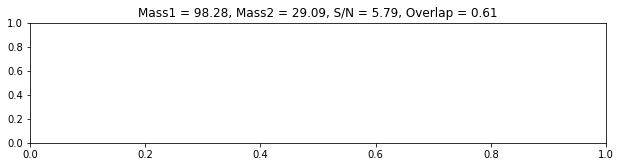

In [46]:
overlaps_10 = []

for i in range(25):
    pure_signals = np.pad(f1['injection_parameters']['l1_signal_whitened'][i].astype(np.float64), (5,5), constant_values=(0,0))   
    strain = np.pad(f1['injection_samples']['l1_strain'][i].astype(np.float64), (5,5), constant_values=(0,0))
    psd = f1['injection_parameters']['psd_noise_l1'][i].astype(np.float64)
    
    m1 = f1['injection_parameters']['mass1'][i]
    m2 = f1['injection_parameters']['mass2'][i]
    snr = f1['injection_parameters']['l1_snr'][i]*f1['injection_parameters']['scale_factor'][i]
    
    overlaps_10.append(plot_reconstructed(decoded_signals2[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr, psd))


for i in range(5):
    
    pure_signals = np.pad(f1['noise_parameters']['l1_signal_whitened'][i].astype(np.float64), (5,5), constant_values=(0,0))     
    strain = np.pad(f1['noise_samples']['l1_strain'][i].astype(np.float64), (5,5), constant_values=(0,0))
    
    m1 = 999 + i
    m2 = 999 + i
    snr = 999 + i
        
    plot_reconstructed(decoded_signals_pure_noise2[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr, psd)
    

# SNR - 8 to 10 (25 timesteps model)

<ipython-input-38-f5335e0d8b93>:35: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(10,5))


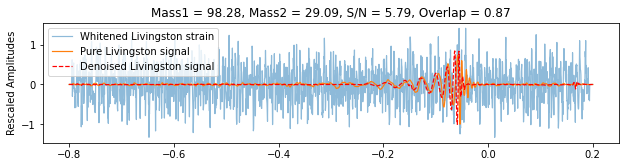

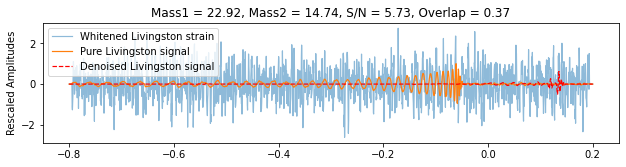

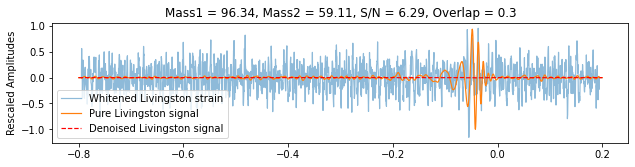

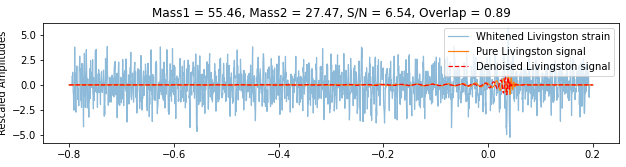

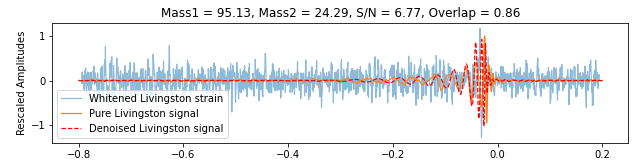

...

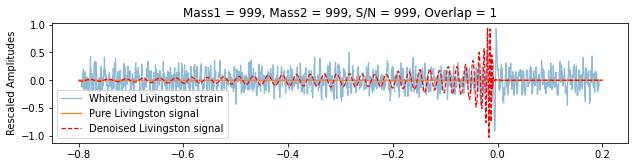

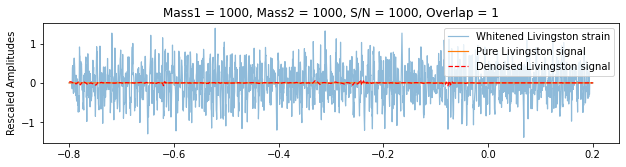

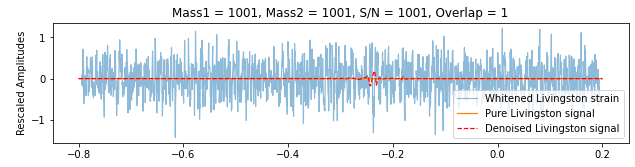

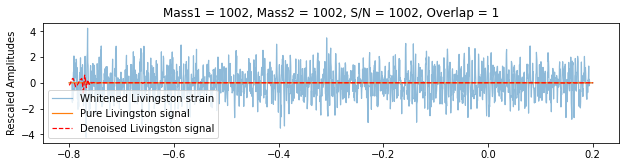

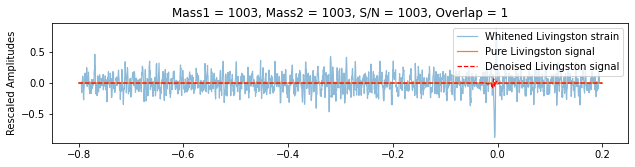

In [39]:
overlaps_25 = []

for i in range(25):
    pure_signals = np.pad(f1['injection_parameters']['l1_signal_whitened'][i].astype(np.float64), (12,13), constant_values=(0,0))   
    strain = np.pad(f1['injection_samples']['l1_strain'][i].astype(np.float64), (12,13), constant_values=(0,0))
    psd = f1['injection_parameters']['psd_noise_l1'][i].astype(np.float64)
    
    m1 = f1['injection_parameters']['mass1'][i]
    m2 = f1['injection_parameters']['mass2'][i]
    snr = f1['injection_parameters']['l1_snr'][i]*f1['injection_parameters']['scale_factor'][i]
    
    overlaps_25.append(plot_reconstructed(decoded_signals[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr, psd))


for i in range(5):
    
    pure_signals = np.pad(f1['noise_parameters']['l1_signal_whitened'][i].astype(np.float64), (12,13), constant_values=(0,0))     
    strain = np.pad(f1['noise_samples']['l1_strain'][i].astype(np.float64), (12,13), constant_values=(0,0))
    psd = f1['injection_parameters']['psd_noise_l1'][i].astype(np.float64)
    
    m1 = 999 + i
    m2 = 999 + i
    snr = 999 + i
        
    plot_reconstructed(decoded_signals_pure_noise[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr, psd)
    

# SNR - 10 to 20 (10 timesteps)

<ipython-input-71-f5335e0d8b93>:35: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(10,5))


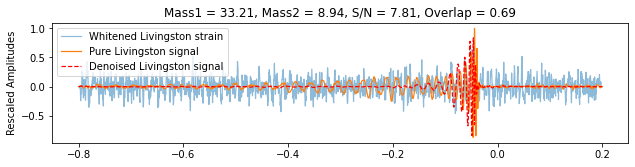

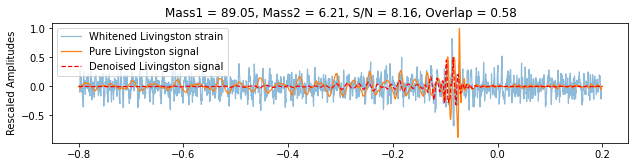

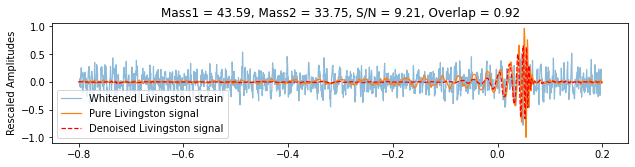

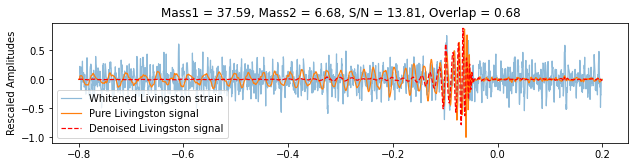

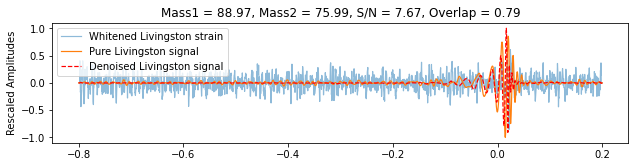

...

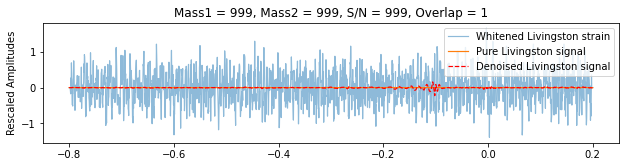

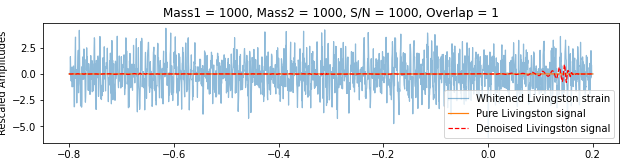

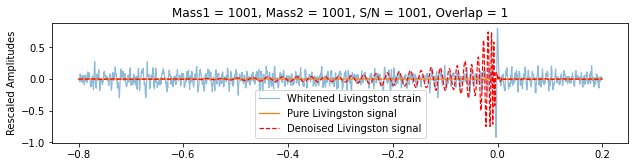

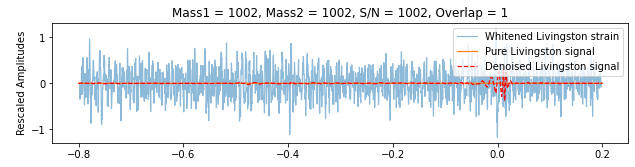

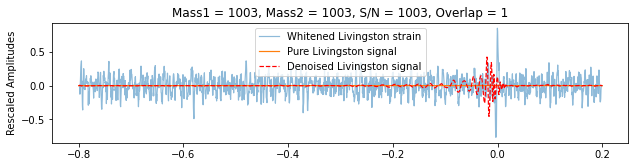

In [73]:
overlaps_10 = []

for i in range(25):
    pure_signals = np.pad(f1['injection_parameters']['l1_signal_whitened'][i].astype(np.float64), (5,5), constant_values=(0,0))   
    strain = np.pad(f1['injection_samples']['l1_strain'][i].astype(np.float64), (5,5), constant_values=(0,0))
    psd = f1['injection_parameters']['psd_noise_l1'][i].astype(np.float64)
    
    m1 = f1['injection_parameters']['mass1'][i]
    m2 = f1['injection_parameters']['mass2'][i]
    snr = f1['injection_parameters']['l1_snr'][i]*f1['injection_parameters']['scale_factor'][i]
    
    overlaps_10.append(plot_reconstructed(decoded_signals[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr, psd))


for i in range(5):
    
    pure_signals = np.pad(f1['noise_parameters']['l1_signal_whitened'][i].astype(np.float64), (5,5), constant_values=(0,0))     
    strain = np.pad(f1['noise_samples']['l1_strain'][i].astype(np.float64), (5,5), constant_values=(0,0))
    
    m1 = 999 + i
    m2 = 999 + i
    snr = 999 + i
        
    plot_reconstructed(decoded_signals_pure_noise[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr, psd)
    

<ipython-input-26-f5335e0d8b93>:35: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(10,5))


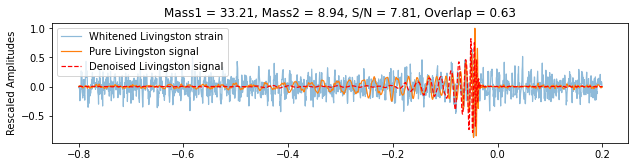

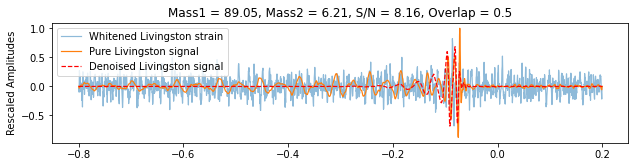

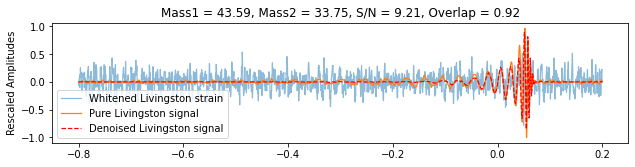

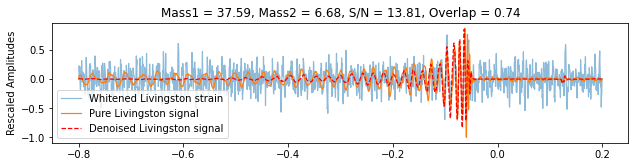

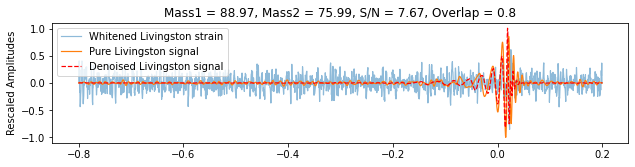

...

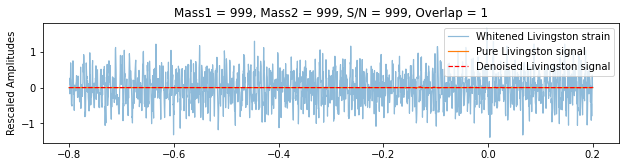

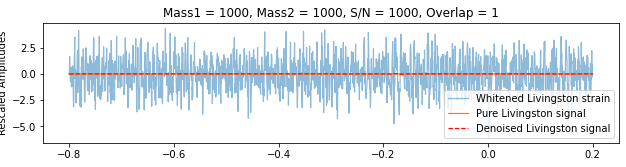

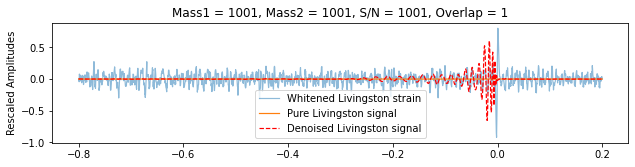

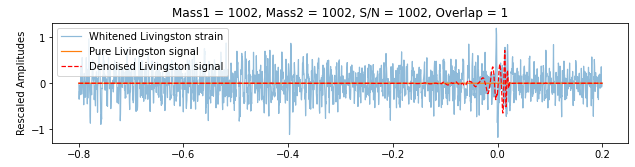

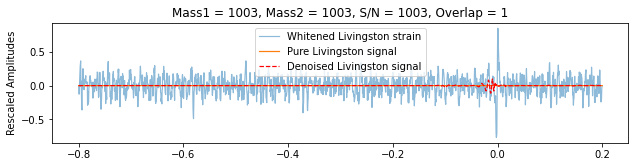

In [27]:
overlaps_10 = []

for i in range(25):
    pure_signals = np.pad(f1['injection_parameters']['l1_signal_whitened'][i].astype(np.float64), (2,2), constant_values=(0,0))   
    strain = np.pad(f1['injection_samples']['l1_strain'][i].astype(np.float64), (2,2), constant_values=(0,0))
    psd = f1['injection_parameters']['psd_noise_l1'][i].astype(np.float64)
    
    m1 = f1['injection_parameters']['mass1'][i]
    m2 = f1['injection_parameters']['mass2'][i]
    snr = f1['injection_parameters']['l1_snr'][i]*f1['injection_parameters']['scale_factor'][i]
    
    overlaps_10.append(plot_reconstructed(decoded_signals[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr, psd))


for i in range(5):
    
    pure_signals = np.pad(f1['noise_parameters']['l1_signal_whitened'][i].astype(np.float64), (2,2), constant_values=(0,0))     
    strain = np.pad(f1['noise_samples']['l1_strain'][i].astype(np.float64), (2,2), constant_values=(0,0))
    
    m1 = 999 + i
    m2 = 999 + i
    snr = 999 + i
        
    plot_reconstructed(decoded_signals_pure_noise[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr, psd)
    

# SNR - 10 to 20 (25 timesteps)

<ipython-input-86-40215b5c4090>:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(10,5))


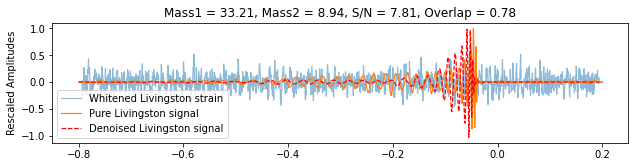

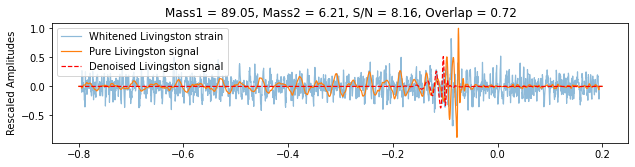

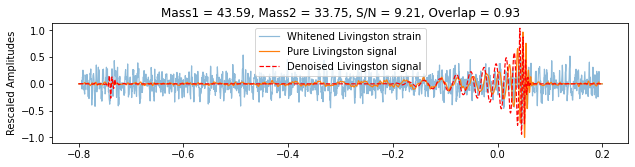

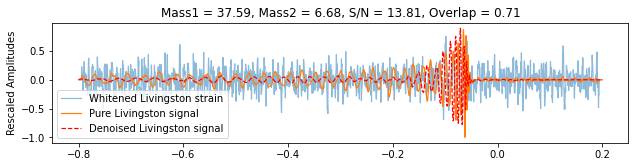

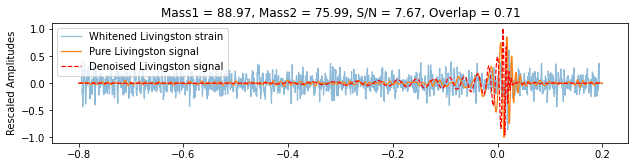

...

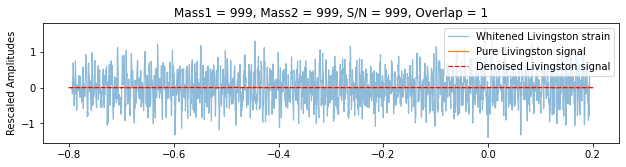

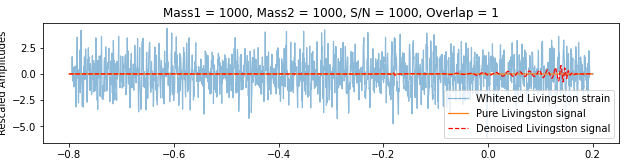

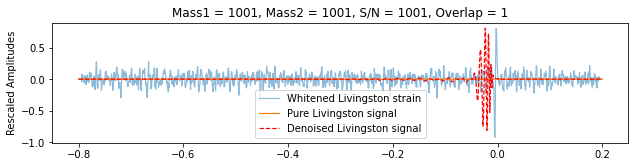

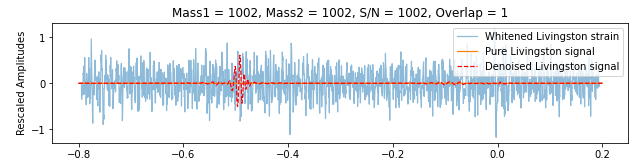

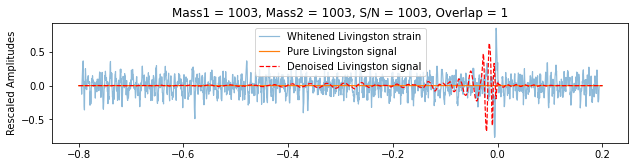

In [87]:
overlaps_25 = []

for i in range(25):
    pure_signals = np.pad(f1['injection_parameters']['l1_signal_whitened'][i].astype(np.float64), (12,13), constant_values=(0,0))   
    strain = np.pad(f1['injection_samples']['l1_strain'][i].astype(np.float64), (12,13), constant_values=(0,0))
    
    m1 = f1['injection_parameters']['mass1'][i]
    m2 = f1['injection_parameters']['mass2'][i]
    snr = f1['injection_parameters']['l1_snr'][i]*f1['injection_parameters']['scale_factor'][i]
    
    overlaps_25.append(plot_reconstructed(decoded_signals[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr))


for i in range(5):
    
    pure_signals = np.pad(f1['noise_parameters']['l1_signal_whitened'][i].astype(np.float64), (12,13), constant_values=(0,0))     
    strain = np.pad(f1['noise_samples']['l1_strain'][i].astype(np.float64), (12,13), constant_values=(0,0))
    
    m1 = 999 + i
    m2 = 999 + i
    snr = 999 + i
        
    plot_reconstructed(decoded_signals_pure_noise[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr)
    

# SNR - 20 to 30 (10 timesteps)

<ipython-input-99-40215b5c4090>:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(10,5))


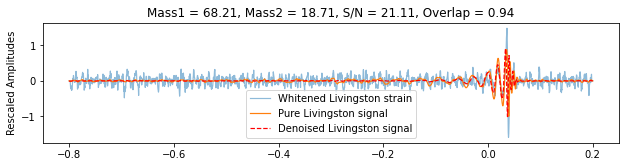

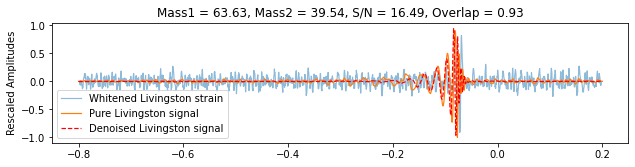

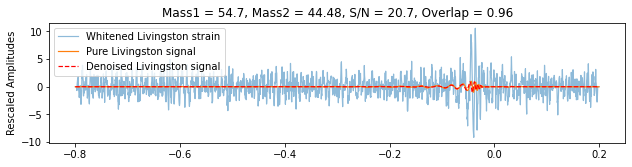

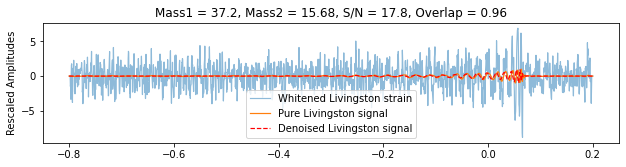

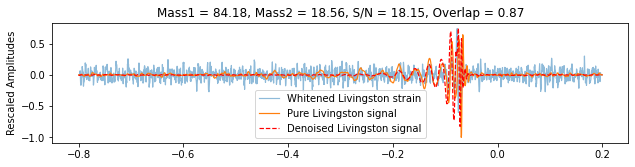

...

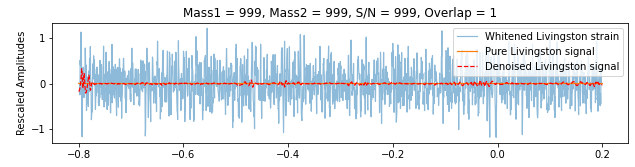

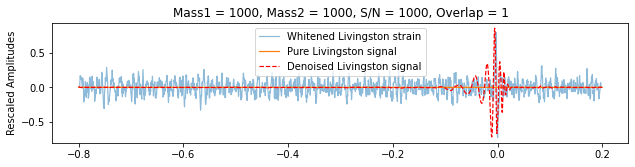

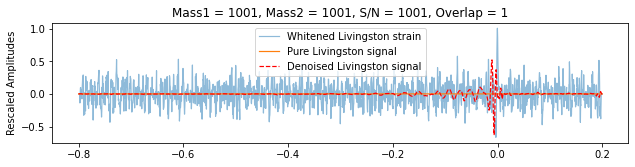

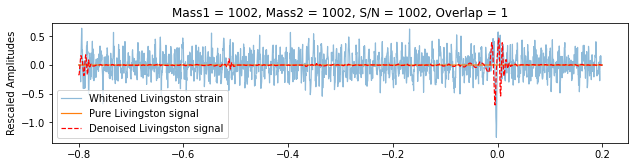

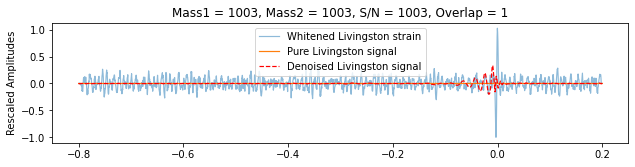

In [100]:
overlaps_10 = []

for i in range(25):
    pure_signals = np.pad(f1['injection_parameters']['l1_signal_whitened'][i].astype(np.float64), (5,5), constant_values=(0,0))   
    strain = np.pad(f1['injection_samples']['l1_strain'][i].astype(np.float64), (5,5), constant_values=(0,0))
    
    m1 = f1['injection_parameters']['mass1'][i]
    m2 = f1['injection_parameters']['mass2'][i]
    snr = f1['injection_parameters']['l1_snr'][i]*f1['injection_parameters']['scale_factor'][i]
    
    overlaps_10.append(plot_reconstructed(decoded_signals[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr))


for i in range(5):
    
    pure_signals = np.pad(f1['noise_parameters']['l1_signal_whitened'][i].astype(np.float64), (5,5), constant_values=(0,0))     
    strain = np.pad(f1['noise_samples']['l1_strain'][i].astype(np.float64), (5,5), constant_values=(0,0))
    
    m1 = 999 + i
    m2 = 999 + i
    snr = 999 + i
        
    plot_reconstructed(decoded_signals_pure_noise[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr)
    

# SNR - 20 to 30 (25 timesteps)

<ipython-input-110-40215b5c4090>:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(10,5))


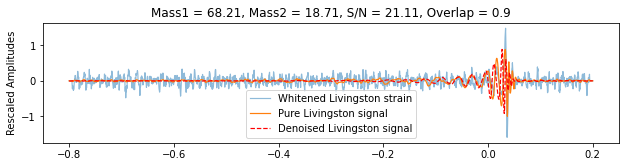

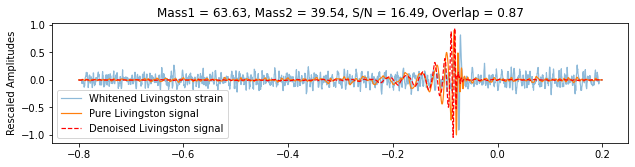

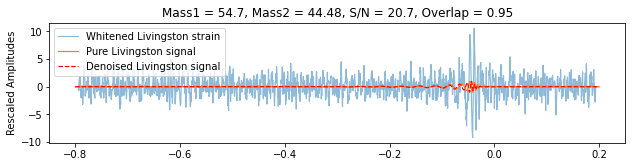

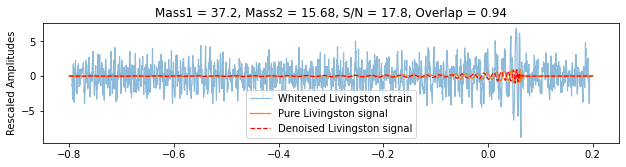

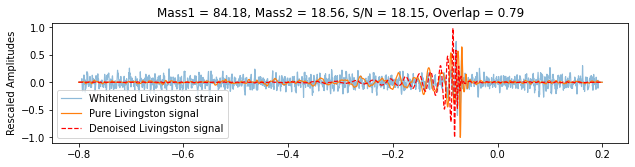

...

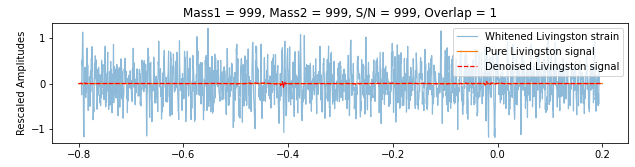

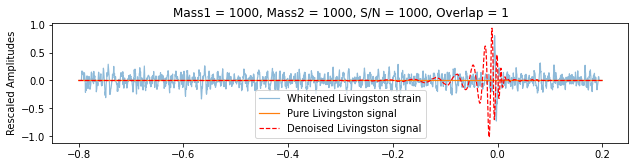

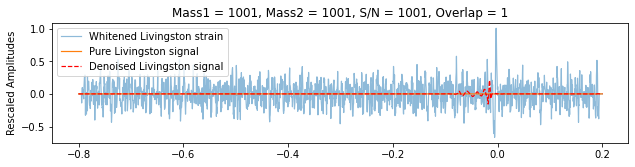

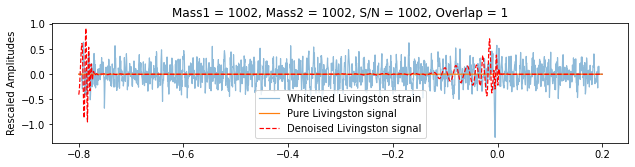

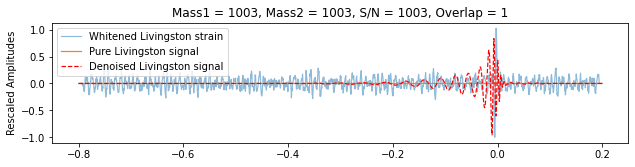

In [111]:
overlaps_25 = []

for i in range(25):
    pure_signals = np.pad(f1['injection_parameters']['l1_signal_whitened'][i].astype(np.float64), (12,13), constant_values=(0,0))   
    strain = np.pad(f1['injection_samples']['l1_strain'][i].astype(np.float64), (12,13), constant_values=(0,0))
    
    m1 = f1['injection_parameters']['mass1'][i]
    m2 = f1['injection_parameters']['mass2'][i]
    snr = f1['injection_parameters']['l1_snr'][i]*f1['injection_parameters']['scale_factor'][i]
    
    overlaps_25.append(plot_reconstructed(decoded_signals[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr))


for i in range(5):
    
    pure_signals = np.pad(f1['noise_parameters']['l1_signal_whitened'][i].astype(np.float64), (12,13), constant_values=(0,0))     
    strain = np.pad(f1['noise_samples']['l1_strain'][i].astype(np.float64), (12,13), constant_values=(0,0))
    
    m1 = 999 + i
    m2 = 999 + i
    snr = 999 + i
        
    plot_reconstructed(decoded_signals_pure_noise[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr)
    

# SNR - 30 to 40 (10 timesteps)

<ipython-input-138-40215b5c4090>:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(10,5))


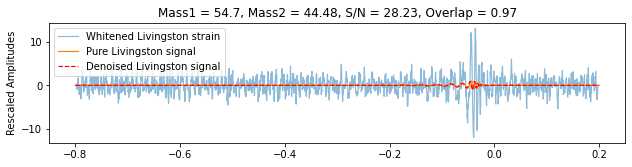

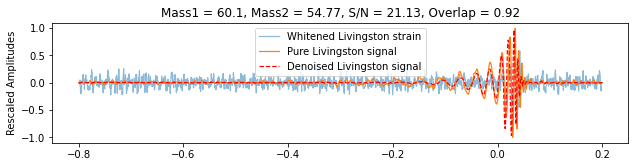

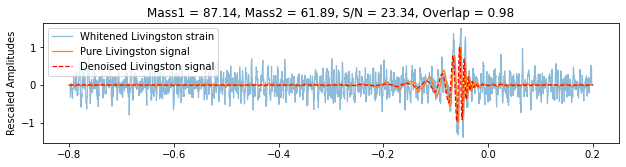

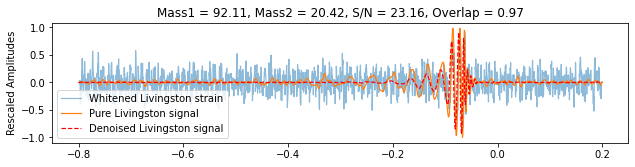

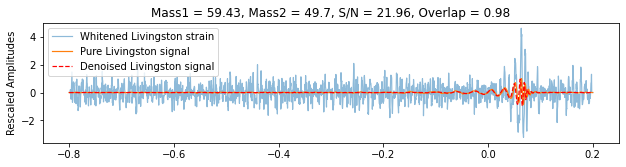

...

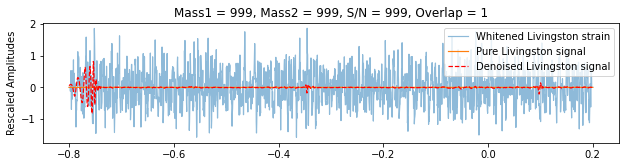

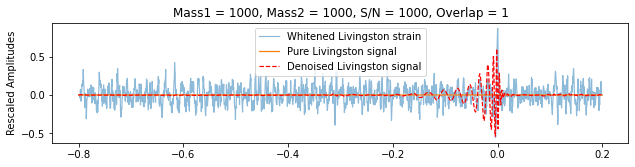

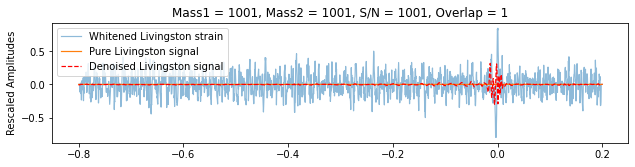

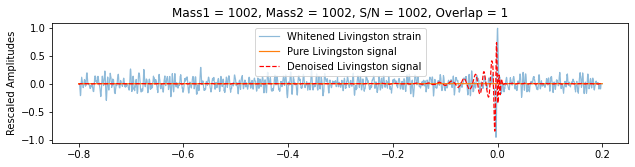

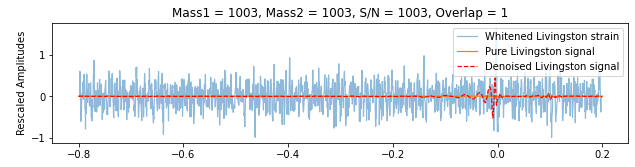

In [139]:
overlaps_10 = []

for i in range(25):
    pure_signals = np.pad(f1['injection_parameters']['l1_signal_whitened'][i].astype(np.float64), (5,5), constant_values=(0,0))   
    strain = np.pad(f1['injection_samples']['l1_strain'][i].astype(np.float64), (5,5), constant_values=(0,0))
    
    m1 = f1['injection_parameters']['mass1'][i]
    m2 = f1['injection_parameters']['mass2'][i]
    snr = f1['injection_parameters']['l1_snr'][i]*f1['injection_parameters']['scale_factor'][i]
    
    overlaps_10.append(plot_reconstructed(decoded_signals[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr))


for i in range(5):
    
    pure_signals = np.pad(f1['noise_parameters']['l1_signal_whitened'][i].astype(np.float64), (5,5), constant_values=(0,0))     
    strain = np.pad(f1['noise_samples']['l1_strain'][i].astype(np.float64), (5,5), constant_values=(0,0))
    
    m1 = 999 + i
    m2 = 999 + i
    snr = 999 + i
        
    plot_reconstructed(decoded_signals_pure_noise[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr)
    

# SNR - 30 to 40 (25 timesteps)

<ipython-input-149-40215b5c4090>:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(10,5))


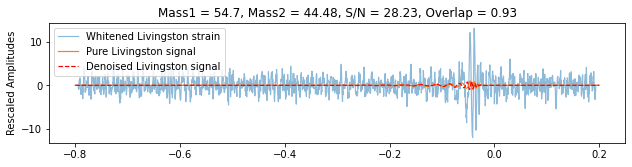

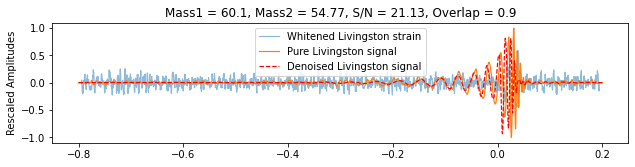

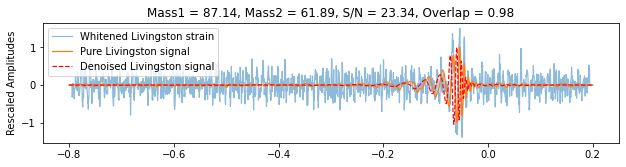

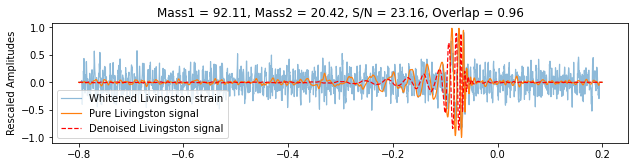

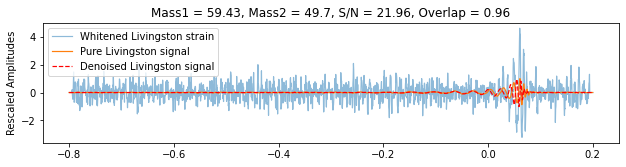

...

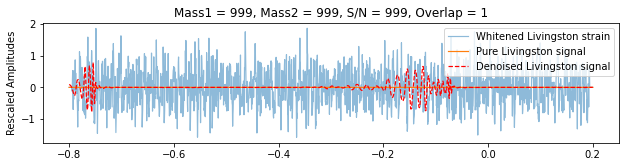

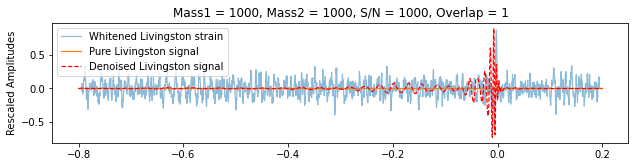

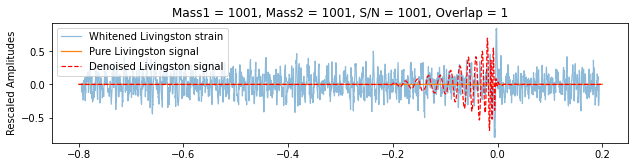

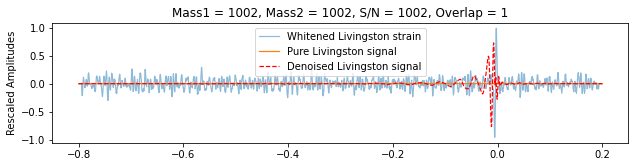

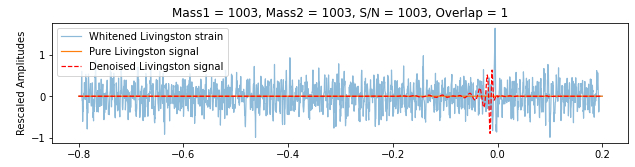

In [150]:
overlaps_25 = []

for i in range(25):
    pure_signals = np.pad(f1['injection_parameters']['l1_signal_whitened'][i].astype(np.float64), (12,13), constant_values=(0,0))   
    strain = np.pad(f1['injection_samples']['l1_strain'][i].astype(np.float64), (12,13), constant_values=(0,0))
    
    m1 = f1['injection_parameters']['mass1'][i]
    m2 = f1['injection_parameters']['mass2'][i]
    snr = f1['injection_parameters']['l1_snr'][i]*f1['injection_parameters']['scale_factor'][i]
    
    overlaps_25.append(plot_reconstructed(decoded_signals[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr))


for i in range(5):
    
    pure_signals = np.pad(f1['noise_parameters']['l1_signal_whitened'][i].astype(np.float64), (12,13), constant_values=(0,0))     
    strain = np.pad(f1['noise_samples']['l1_strain'][i].astype(np.float64), (12,13), constant_values=(0,0))
    
    m1 = 999 + i
    m2 = 999 + i
    snr = 999 + i
        
    plot_reconstructed(decoded_signals_pure_noise[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr)
    

In [37]:
#f1 = h5py.File('/fred/oz016/Chayan/BBH_sample_files/O3b_test_IMRPhenomXPHM_SNR-8to10_mchirp_all_500.hdf', 'r')
#f2 = h5py.File('/fred/oz016/Chayan/BBH_sample_files/O3b_test_IMRPhenomXPHM_SNR-10to20_mchirp_all_500.hdf', 'r')
#f3 = h5py.File('/fred/oz016/Chayan/BBH_sample_files/O3b_test_IMRPhenomXPHM_SNR-20to30_mchirp_all_500.hdf', 'r')
#f4 = h5py.File('/fred/oz016/Chayan/BBH_sample_files/O3b_test_IMRPhenomXPHM_SNR-30to40_mchirp_all_500.hdf', 'r')

f1 = h5py.File('/fred/oz016/Chayan/samplegen_old/output/O3b_test_IMRPhenomXPHM_SNR-8to10_mchirp_all_250_30Hz.hdf', 'r')
f2 = h5py.File('/fred/oz016/Chayan/samplegen_old/output/O3b_test_IMRPhenomXPHM_SNR-10to20_mchirp_all_250_30Hz.hdf', 'r')
f3 = h5py.File('/fred/oz016/Chayan/samplegen_old/output/O3b_test_IMRPhenomXPHM_SNR-20to30_mchirp_all_250_30Hz.hdf', 'r')
f4 = h5py.File('/fred/oz016/Chayan/samplegen_old/output/O3b_test_IMRPhenomXPHM_SNR-30to40_mchirp_all_250_30Hz.hdf', 'r')

strain_1 = f1['injection_samples']['l1_strain'][()]
strain_2 = f2['injection_samples']['l1_strain'][()]
strain_3 = f3['injection_samples']['l1_strain'][()]
strain_4 = f4['injection_samples']['l1_strain'][()]

signal_1 = f1['injection_parameters']['l1_signal_whitened'][()]
signal_2 = f2['injection_parameters']['l1_signal_whitened'][()]
signal_3 = f3['injection_parameters']['l1_signal_whitened'][()]
signal_4 = f4['injection_parameters']['l1_signal_whitened'][()]

strain = np.concatenate([strain_1, strain_2, strain_3, strain_4], axis=0)
signal = np.concatenate([signal_1, signal_2, signal_3, signal_4], axis=0)


In [38]:
mass_1_1 = f1['injection_parameters']['mass1'][()]
mass_1_2 = f2['injection_parameters']['mass1'][()]
mass_1_3 = f3['injection_parameters']['mass1'][()]
mass_1_4 = f4['injection_parameters']['mass1'][()]

mass_2_1 = f1['injection_parameters']['mass2'][()]
mass_2_2 = f2['injection_parameters']['mass2'][()]
mass_2_3 = f3['injection_parameters']['mass2'][()]
mass_2_4 = f4['injection_parameters']['mass2'][()]

snr_1 = f1['injection_parameters']['l1_snr'][()]*f1['injection_parameters']['scale_factor'][()]
snr_2 = f2['injection_parameters']['l1_snr'][()]*f2['injection_parameters']['scale_factor'][()]
snr_3 = f3['injection_parameters']['l1_snr'][()]*f3['injection_parameters']['scale_factor'][()]
snr_4 = f4['injection_parameters']['l1_snr'][()]*f4['injection_parameters']['scale_factor'][()]

spin_1a_1 = f1['injection_parameters']['spin1_a'][()]
spin_1a_2 = f2['injection_parameters']['spin1_a'][()]
spin_1a_3 = f3['injection_parameters']['spin1_a'][()]
spin_1a_4 = f4['injection_parameters']['spin1_a'][()]

spin_2a_1 = f1['injection_parameters']['spin2_a'][()]
spin_2a_2 = f2['injection_parameters']['spin2_a'][()]
spin_2a_3 = f3['injection_parameters']['spin2_a'][()]
spin_2a_4 = f4['injection_parameters']['spin2_a'][()]

spin_1_polar_1 = f1['injection_parameters']['spin1_polar'][()]
spin_1_polar_2 = f2['injection_parameters']['spin1_polar'][()]
spin_1_polar_3 = f3['injection_parameters']['spin1_polar'][()]
spin_1_polar_4 = f4['injection_parameters']['spin1_polar'][()]

spin_2_polar_1 = f1['injection_parameters']['spin2_polar'][()]
spin_2_polar_2 = f2['injection_parameters']['spin2_polar'][()]
spin_2_polar_3 = f3['injection_parameters']['spin2_polar'][()]
spin_2_polar_4 = f4['injection_parameters']['spin2_polar'][()]

spin_1_azimuthal_1 = f1['injection_parameters']['spin1_azimuthal'][()]
spin_1_azimuthal_2 = f2['injection_parameters']['spin1_azimuthal'][()]
spin_1_azimuthal_3 = f3['injection_parameters']['spin1_azimuthal'][()]
spin_1_azimuthal_4 = f4['injection_parameters']['spin1_azimuthal'][()]

spin_2_azimuthal_1 = f1['injection_parameters']['spin2_azimuthal'][()]
spin_2_azimuthal_2 = f2['injection_parameters']['spin2_azimuthal'][()]
spin_2_azimuthal_3 = f3['injection_parameters']['spin2_azimuthal'][()]
spin_2_azimuthal_4 = f4['injection_parameters']['spin2_azimuthal'][()]

psd_l1_1 = f1['injection_parameters']['psd_noise_l1'][()]
psd_l1_2 = f2['injection_parameters']['psd_noise_l1'][()]
psd_l1_3 = f3['injection_parameters']['psd_noise_l1'][()]
psd_l1_4 = f4['injection_parameters']['psd_noise_l1'][()]

mass_1 = np.concatenate([mass_1_1, mass_1_2, mass_1_3, mass_1_4], axis=0)
mass_2 = np.concatenate([mass_2_1, mass_2_2, mass_2_3, mass_2_4], axis=0)

snr = np.concatenate([snr_1, snr_2, snr_3, snr_4], axis=0)

spin1a = np.concatenate([spin_1a_1, spin_1a_2, spin_1a_3, spin_1a_4], axis=0)
spin2a = np.concatenate([spin_2a_1, spin_2a_2, spin_2a_3, spin_2a_4], axis=0)

spin1_polar = np.concatenate([spin_1_polar_1, spin_1_polar_2, spin_1_polar_3, spin_1_polar_4], axis=0)
spin2_polar = np.concatenate([spin_2_polar_1, spin_2_polar_2, spin_2_polar_3, spin_2_polar_4], axis=0)

spin1_azimuthal = np.concatenate([spin_1_azimuthal_1, spin_1_azimuthal_2, spin_1_azimuthal_3, spin_1_azimuthal_4], axis=0)
spin2_azimuthal = np.concatenate([spin_2_azimuthal_1, spin_2_azimuthal_2, spin_2_azimuthal_3, spin_2_azimuthal_4], axis=0)

psd_l1 = np.concatenate([psd_l1_1, psd_l1_2, psd_l1_3, psd_l1_4], axis=0)


In [39]:
strain, maximum, minimum = _preprocess_data(strain, strain.shape[0], 2048)
strain = np.array(strain)
strain.shape


(1000, 2048)

In [40]:
X_test_strain = reshape_sequences(strain.shape[0], strain)
X_test_pure_signal = reshape_sequences(signal.shape[0], signal)


In [41]:
# Reshape arrays to fit into Keras model
X_test_strain = X_test_strain[:,:,:,None]
print('x_test_strain shape:', X_test_strain.shape)
X_test_strain = X_test_strain.astype("float32")

X_test_pure_signal = X_test_pure_signal[:,:,:,None]
print('x_test_pure_signal shape:', X_test_pure_signal.shape)
X_test_pure_signal = X_test_pure_signal.astype("float32")


x_test_strain shape: (1000, 2063, 15, 1)
x_test_pure_signal shape: (1000, 2063, 15, 1)


In [42]:
class TimeDistributedMultiHeadAttention(tf.keras.layers.Layer):
        def __init__(self, num_heads, key_dim, **kwargs):
            super().__init__(**kwargs)
            self.num_heads = num_heads
            self.key_dim = key_dim
            self.multi_head_attention = tf.keras.layers.MultiHeadAttention(num_heads=num_heads, key_dim=key_dim)

        def call(self, inputs):
            # Use tf.shape for dynamic shape and inputs.shape for static shape
            shape = tf.shape(inputs)
            static_shape = inputs.shape
            batch_size, num_subsequences, subsequence_length = shape[0], static_shape[1], static_shape[2]
            features = static_shape[3]

            reshaped_inputs = tf.reshape(inputs, [-1, subsequence_length, features])

            # Apply multi-head attention to each subsequence individually
            attention_output = self.multi_head_attention(reshaped_inputs, reshaped_inputs)

            # Reshape the output back to the original input shape
            output_shape = [-1, num_subsequences, subsequence_length, features]
            return tf.reshape(attention_output, output_shape)

        def compute_output_shape(self, input_shape):
            return input_shape
        
        def get_config(self):
            config = super().get_config()
            config.update({
                'num_heads': self.num_heads,
                'key_dim': self.key_dim
            })
            return config


In [43]:
#from keras.models import load_model

#model = tf.keras.models.load_model('/fred/oz016/Chayan/GW-Denoiser/model/model_IMRPhenomXPHM_O3b_noise_old_model_4_timesteps_mchirp_all.h5', custom_objects={'FractalTanimotoLoss': FractalTanimotoLoss, 'AttentionLayer': AttentionLayer})

#model1 = tf.keras.models.load_model('/fred/oz016/Chayan/GW-Denoiser/model/trained_model_test_IMBH_HM_O3b_noise_mass_corrected.h5', custom_objects={'FractalTanimotoLoss': FractalTanimotoLoss})

#model2 = tf.keras.models.load_model('/fred/oz016/Chayan/GW-Denoiser/model/model_IMRPhenomXPHM_O3b_noise_10_timesteps_attention_30Hz.h5', custom_objects={'FractalTanimotoLoss': FractalTanimotoLoss, 'AttentionLayer': AttentionLayer})

#model3 = tf.keras.models.load_model('/fred/oz016/Chayan/GW-Denoiser/model/model_IMRPhenomXPHM_O3b_noise_10_timesteps_attention_30Hz_FT_loss.h5', custom_objects={'FractalTanimotoLoss': FractalTanimotoLoss, 'AttentionLayer': AttentionLayer})

#model4 = tf.keras.models.load_model('/fred/oz016/Chayan/GW-Denoiser/model/model_IMRPhenomXPHM_O3b_noise_10_timesteps_attention_30Hz_FT_loss_larger_model.h5', custom_objects={'FractalTanimotoLoss': FractalTanimotoLoss, 'AttentionLayer': AttentionLayer})

#model5 = tf.keras.models.load_model('/fred/oz016/Chayan/GW-Denoiser/model/model_IMRPhenomXPHM_O3b_noise_10_timesteps_attention_30Hz_FT_loss_larger_model_1.h5', custom_objects={'FractalTanimotoLoss': FractalTanimotoLoss, 'AttentionLayer': AttentionLayer})

#model6 = tf.keras.models.load_model('/fred/oz016/Chayan/GW-Denoiser/model/model_IMRPhenomXPHM_O3b_noise_10_timesteps_attention_30Hz_FT_loss_larger_model_no_attention.h5', custom_objects={'FractalTanimotoLoss': FractalTanimotoLoss, 'AttentionLayer': AttentionLayer})

#model7 = tf.keras.models.load_model('/fred/oz016/Chayan/GW-Denoiser/model/model_IMRPhenomXPHM_O3b_noise_10_timesteps_attention_30Hz_FT_loss_larger_model_mse_loss.h5', custom_objects={'FractalTanimotoLoss': FractalTanimotoLoss, 'AttentionLayer': AttentionLayer})

#model8 = tf.keras.models.load_model('/fred/oz016/Chayan/GW-Denoiser/model/model_IMRPhenomXPHM_O3b_noise_10_timesteps_attention_30Hz_FT_loss_larger_model_mse_loss_1.h5', custom_objects={'FractalTanimotoLoss': FractalTanimotoLoss, 'AttentionLayer': AttentionLayer})

#model9 = tf.keras.models.load_model('/fred/oz016/Chayan/GW-Denoiser/model/model_IMRPhenomXPHM_O3b_noise_25_timesteps_30Hz_mse_loss_larger_model.h5', custom_objects={'FractalTanimotoLoss': FractalTanimotoLoss, 'AttentionLayer': AttentionLayer})

#model = tf.keras.models.load_model('/fred/oz016/Chayan/GW-Denoiser/model/model_IMRPhenomXPHM_O3b_noise_4_timesteps_old_model_new_training_data.h5', custom_objects={'FractalTanimotoLoss': FractalTanimotoLoss, 'AttentionLayer': AttentionLayer})    

model10 = tf.keras.models.load_model('/fred/oz016/Chayan/GW-Denoiser/model/model_IMRPhenomXPHM_O3b_noise_10_timesteps_30Hz_mse_loss_larger_model_encoder_attention.h5', custom_objects={'FractalTanimotoLoss': FractalTanimotoLoss, 'TimeDistributedMultiHeadAttention': TimeDistributedMultiHeadAttention})

model11 = tf.keras.models.load_model('/fred/oz016/Chayan/GW-Denoiser/model/model_IMRPhenomXPHM_O3b_noise_10_timesteps_30Hz_mse_loss_larger_model_encoder_attention_1.h5', custom_objects={'FractalTanimotoLoss': FractalTanimotoLoss, 'TimeDistributedMultiHeadAttention': TimeDistributedMultiHeadAttention})


# load model
#model = tf.keras.models.load_model('/fred/oz016/Chayan/GW-Denoiser/model/model_IMRPhenomXPHM_O3b_noise_dilated_CNN_25_timesteps.h5', custom_objects={'FractalTanimotoLoss': FractalTanimotoLoss})

# summarize model.
model10.summary()


Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 batch_normalization (BatchN  (None, 2063, 15, 1)      4         
 ormalization)                                                   
                                                                 
 time_distributed (TimeDistr  (None, 2063, 15, 64)     256       
 ibuted)                                                         
                                                                 
 time_distributed_1 (TimeDis  (None, 2063, 15, 32)     6176      
 tributed)                                                       
                                                                 
 dropout (Dropout)           (None, 2063, 15, 32)      0         
                                                                 
 batch_normalization_1 (Batc  (None, 2063, 15, 32)     128       
 hNormalization)                                        

In [44]:
#decoded_signals1 = model1.predict(X_test_strain, batch_size=50)
#decoded_signals2 = model2.predict(X_test_strain, batch_size=50)
#decoded_signals3 = model3.predict(X_test_strain, batch_size=50)
#decoded_signals4 = model4.predict(X_test_strain, batch_size=50)
#decoded_signals5 = model5.predict(X_test_strain, batch_size=50)
#decoded_signals6 = model6.predict(X_test_strain, batch_size=50)
#decoded_signals7 = model7.predict(X_test_strain, batch_size=50)
#decoded_signals8 = model8.predict(X_test_strain, batch_size=50)
#decoded_signals9 = model9.predict(X_test_strain, batch_size=50)
decoded_signals10 = model10.predict(X_test_strain, batch_size=50)
decoded_signals11 = model11.predict(X_test_strain, batch_size=50)


In [45]:
from pycbc.filter import match, overlap
from pycbc.psd import aLIGOZeroDetHighPower
from pycbc.types.timeseries import TimeSeries, FrequencySeries
import matplotlib.pyplot as plt

#overlaps1 = []
#overlaps2 = []
#overlaps3 = []
#overlaps4 = []
#overlaps5 = []
#overlaps6 = []
#overlaps7 = []
#overlaps8 = []
#overlaps9 = []
overlaps10 = []
overlaps11 = []

def get_overlap(decoded_signal, pure_signal, psd):
    
    time_buffer = 1
    length_signal = len(decoded_signal)

    f_low = 18
    sample_rate = 2048

    # Length of corresponding time series and frequency series
    tlen = sample_rate * time_buffer
    flen = tlen // 2 + 1

    delta_f = 1.0 / time_buffer
#    psd = aLIGOZeroDetHighPower(flen, delta_f, f_low)
    psd = FrequencySeries(psd, delta_f=delta_f)
    
    X_test_pure_ts = TimeSeries(pure_signal.squeeze(), delta_t = 1.0/2048)
    decoded_signals_ts = TimeSeries(decoded_signal.squeeze(), delta_t = 1.0/2048)

    X_test_pure_ts.resize(tlen)
    decoded_signals_ts.resize(tlen)

    m = Overlap_calc(X_test_pure_ts,decoded_signals_ts,psd)
    
    return m

for i in range(decoded_signals10.shape[0]):
#    overlaps1.append(get_overlap(decoded_signals1[i].astype('float64'), signal[i].astype('float64'), psd_l1[i]))
#    overlaps2.append(get_overlap(decoded_signals2[i].astype('float64'), signal[i].astype('float64'), psd_l1[i]))
#    overlaps3.append(get_overlap(decoded_signals3[i].astype('float64'), signal[i].astype('float64'), psd_l1[i]))
#    overlaps4.append(get_overlap(decoded_signals4[i].astype('float64'), signal[i].astype('float64'), psd_l1[i]))
#    overlaps5.append(get_overlap(decoded_signals5[i].astype('float64'), signal[i].astype('float64'), psd_l1[i]))
#    overlaps6.append(get_overlap(decoded_signals6[i].astype('float64'), signal[i].astype('float64'), psd_l1[i]))
#    overlaps7.append(get_overlap(decoded_signals7[i].astype('float64'), signal[i].astype('float64'), psd_l1[i]))
#    overlaps8.append(get_overlap(decoded_signals8[i].astype('float64'), signal[i].astype('float64'), psd_l1[i]))
#    overlaps9.append(get_overlap(decoded_signals9[i].astype('float64'), signal[i].astype('float64'), psd_l1[i]))
    overlaps10.append(get_overlap(decoded_signals10[i].astype('float64'), signal[i].astype('float64'), psd_l1[i]))
    overlaps11.append(get_overlap(decoded_signals11[i].astype('float64'), signal[i].astype('float64'), psd_l1[i]))
    

In [46]:
#overlaps_10_18Hz_training = np.array(overlaps1)
#overlaps_10_30Hz_training = np.array(overlaps2)
#overlaps_10_30Hz_training_FT_loss = np.array(overlaps3)
#overlaps_10_30Hz_training_FT_loss_larger_model = np.array(overlaps4)
#overlaps_10_30Hz_training_FT_loss_larger_model_1 = np.array(overlaps5)
#overlaps_10_30Hz_training_FT_loss_larger_model_no_attention = np.array(overlaps6)
#overlaps_10_30Hz_training_FT_loss_larger_model_no_attention_mse = np.array(overlaps7)
#overlaps_10_30Hz_training_FT_loss_larger_model_no_attention_mse_larger = np.array(overlaps8)
#overlaps_25_30Hz_training_FT_loss_larger_model_no_attention_mse_larger = np.array(overlaps9)
overlaps_10_30Hz_training_multihead_attention_mse = np.array(overlaps10)
overlaps_10_30Hz_training_multihead_attention_mse_1 = np.array(overlaps11)


In [47]:
def get_chirp_mass(mass1, mass2):
     
    return ((mass1*mass2)**(3.0/5))/(mass_1+mass_2)**(1.0/5) 
    

In [48]:
m_chirp = get_chirp_mass(mass_1, mass_2)


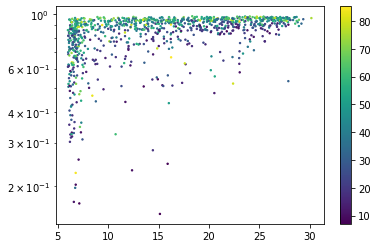

In [70]:
# 30 Hz test set (250 each)

index = np.where((snr>6.0))

plt.scatter(snr[index], overlaps_10_18Hz_training[index], s=2, c=m_chirp[index], cmap='viridis')
plt.yscale('log')
plt.colorbar()


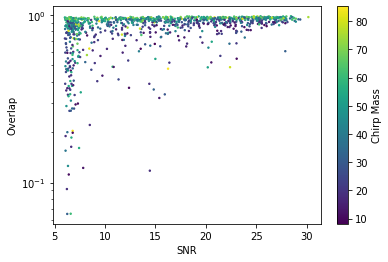

In [35]:
import numpy as np
import matplotlib.pyplot as plt

# Assuming snr, overlaps_10_30Hz_training, and m_chirp are defined arrays

index = np.where((snr>6.0) & (m_chirp > 8.0))

plt.scatter(snr[index], overlaps_10_30Hz_training[index], s=2, c=m_chirp[index], cmap='viridis')
plt.yscale('log')
plt.ylabel('Overlap')
plt.xlabel('SNR')

# Create colorbar and add label
cbar = plt.colorbar()
cbar.set_label('Chirp Mass')

#plt.savefig('Test_plots/Overlap_vs_SNR_chirp_mass.png', dpi=200)


In [26]:
import numpy as np
import matplotlib.pyplot as plt

# Assuming snr, overlaps_10_30Hz_training, and m_chirp are defined arrays

index = np.where((snr>6.0))

plt.scatter(snr[index], overlaps_10_30Hz_training_FT_loss_larger_model_no_attention_mse[index], s=2, c=m_chirp[index], cmap='viridis')
plt.yscale('log')
plt.ylabel('Overlap')
plt.xlabel('SNR')

# Create colorbar and add label
cbar = plt.colorbar()
cbar.set_label('Chirp Mass')

#plt.savefig('Test_plots/Overlap_vs_SNR_chirp_mass.png', dpi=200)


NameError: name 'overlaps_10_30Hz_training_FT_loss_larger_model_no_attention_mse' is not defined

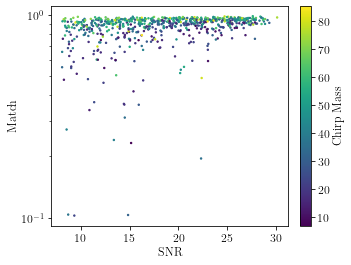

In [54]:
import numpy as np
import matplotlib.pyplot as plt

# Assuming snr, overlaps_10_30Hz_training, and m_chirp are defined arrays

index = np.where((snr>8.0)&(overlaps_10_30Hz_training_multihead_attention_mse>0.1))

mlb.setup_page(**mlb.formats.article_letterpaper_10pt_singlecolumn)

#fig = mlb.figure_textwidth()  # for full page images
fig = mlb.figure_columnwidth()  # for full column images

# Increase the font size of the numbers on the axes
plt.xticks(fontsize=12)  # Increase fontsize for x-axis tick labels
plt.yticks(fontsize=12)  # Increase fontsize for y-axis tick labels

plt.scatter(snr[index], overlaps_10_30Hz_training_multihead_attention_mse[index], s=2, c=m_chirp[index], cmap='viridis')
plt.yscale('log')
plt.ylabel('Match', fontsize=12)
plt.xlabel('SNR', fontsize=12)

# Create colorbar and add label
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=12)
cbar.set_label('Chirp Mass', fontsize=12)

#plt.savefig('Test_plots/Overlap_vs_SNR_chirp_mass.png', dpi=200)


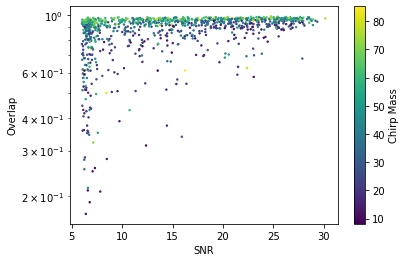

In [28]:
import numpy as np
import matplotlib.pyplot as plt

# Assuming snr, overlaps_10_30Hz_training, and m_chirp are defined arrays

index = np.where((snr>6.0) & (m_chirp > 8.0))

plt.scatter(snr[index], overlaps_10_30Hz_training_multihead_attention_mse_1[index], s=2, c=m_chirp[index], cmap='viridis')
plt.yscale('log')
plt.ylabel('Overlap')
plt.xlabel('SNR')

# Create colorbar and add label
cbar = plt.colorbar()
cbar.set_label('Chirp Mass')

#plt.savefig('Test_plots/Overlap_vs_SNR_chirp_mass.png', dpi=200)


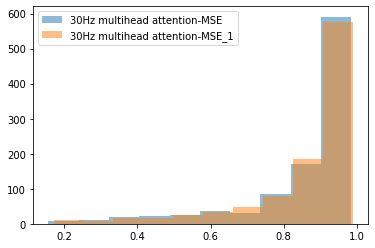

In [29]:
#plt.hist(overlaps_10_18Hz_training, alpha=0.5, label='18Hz')
#plt.hist(overlaps_10_30Hz_training, alpha=0.5, label='30Hz')
#plt.hist(overlaps_10_30Hz_training_FT_loss, alpha=0.5, label='30Hz FT')
#plt.hist(overlaps_10_30Hz_training_FT_loss_larger_model, alpha=0.5,label='30Hz FT larger model')
#plt.hist(overlaps_10_30Hz_training_FT_loss_larger_model_1, alpha=0.5,label='30Hz FT larger model-MAE+weight*MSE')
#plt.hist(overlaps_10_30Hz_training_FT_loss_larger_model_no_attention, alpha=0.5,label='30Hz FT larger model-no attention')
#plt.hist(overlaps_10_30Hz_training_FT_loss_larger_model_no_attention_mse, alpha=0.5,label='30Hz larger model-no attention-MSE')
#plt.hist(overlaps_10_30Hz_training_FT_loss_larger_model_no_attention_mse_larger, alpha=0.5,label='30Hz FT larger model-no attention-MSE_larger')
#plt.hist(overlaps_25_30Hz_training_FT_loss_larger_model_no_attention_mse_larger, alpha=0.5,label='30Hz FT larger model-no attention-MSE(25 tsteps)')
plt.hist(overlaps_10_30Hz_training_multihead_attention_mse, alpha=0.5,label='30Hz multihead attention-MSE')
plt.hist(overlaps_10_30Hz_training_multihead_attention_mse_1, alpha=0.5,label='30Hz multihead attention-MSE_1')

plt.legend()


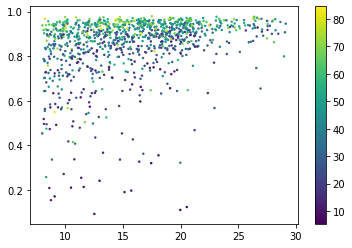

In [42]:
index = np.where(snr>8.0)

plt.scatter(snr[index], overlaps[index], s=2, c=m_chirp[index], cmap='viridis')
plt.colorbar()


(array([  5.,   7.,   8.,   8.,  12.,  35.,  53., 106., 257., 527.]),
 array([0.0794109 , 0.16952362, 0.25963633, 0.34974905, 0.43986177,
        0.52997448, 0.6200872 , 0.71019991, 0.80031263, 0.89042535,
        0.98053806]),
 <BarContainer object of 10 artists>)

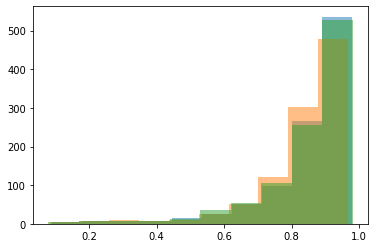

In [126]:
plt.hist(overlaps_old[index], alpha=0.5) # 4 timesteps, chirp mass restricted model. Cannot denoise GW170608 and GW151226
plt.hist(overlaps_new[index], alpha=0.5) # 4 timesteps, no chirp mass restriction. Can denoise GW170608 and GW151226
plt.hist(overlaps_10[index], alpha=0.5) # 10 timesteps, no chirp mass restriction. Can denoise GW170608 and GW151226


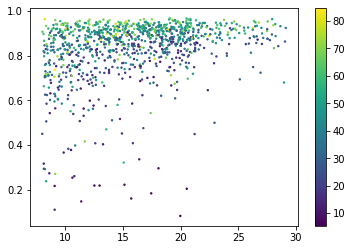

In [30]:
index = np.where(snr>8.0)

plt.scatter(snr[index], overlaps[index], s=2, c=m_chirp[index], cmap='viridis')
plt.colorbar()


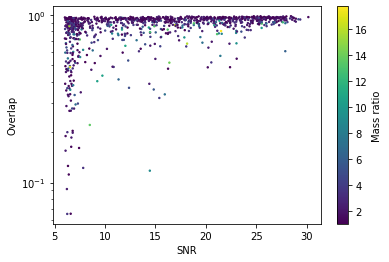

In [89]:
plt.scatter(snr[index], overlaps_10_30Hz_training[index], s=2, c=mass_1[index]/mass_2[index], cmap='viridis')
plt.yscale('log')
plt.ylabel('Overlap')
plt.xlabel('SNR')

# Create colorbar and add label
cbar1 = plt.colorbar()
cbar1.set_label('Mass ratio')

plt.savefig('Test_plots/Overlap_vs_SNR_mass_ratio.png', dpi=200)


In [20]:
from scipy.fft import fft, ifft

def get_snr_frac(decoded_signal):
    
    h_fft = fft(decoded_signal)
    template_fft = fft(decoded_signal)
    snr_freq = (h_fft * template_fft.conjugate())
    snr_time = np.abs(ifft(snr_freq))
    optimal_snr_ml = np.sqrt(np.max(snr_time))

    return optimal_snr_ml


In [32]:
snr_denoised = []
snr_pure = []

snr_frac = []

for i in range(decoded_signals7.shape[0]):
    snr_denoised.append(get_snr_frac((decoded_signals7[i].squeeze()).astype('float64')))
    snr_pure.append(get_snr_frac((signal[i]).astype('float64')))
    
snr_denoised = np.array(snr_denoised)
snr_pure = np.array(snr_pure)

snr_frac = snr_denoised/snr_pure


In [33]:
f_factor = (snr[index]/snr_pure[index])


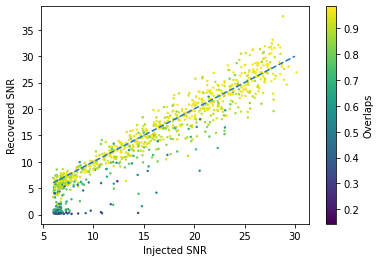

In [35]:
x = np.linspace(6, 30.0, 400)
y=x
plt.scatter(f_factor*snr_pure[index], f_factor*snr_denoised[index], s=2, c=overlaps_10_30Hz_training_FT_loss_larger_model_no_attention_mse[index], cmap='viridis')
plt.plot(x,y, '--')
#plt.xlim(0.3,1.0)
plt.ylabel('Recovered SNR')
plt.xlabel('Injected SNR')

# Create colorbar and add label
cbar = plt.colorbar()
cbar.set_label('Overlaps')

#plt.savefig('Test_plots/Recovered_vs_injected_SNR.png', dpi=200)


In [31]:
def get_chi_eff(m1, m2, spin1a, spin2a, theta_1, theta_2):
    
    a = m1*spin1a*np.cos(theta_1)
    b = m2*spin2a*np.cos(theta_2)
    
    return (a+b)/(m1+m2)
    

In [32]:
def get_chi_p(m1, m2, spin1a, spin2a, theta_1, theta_2):
     
    q = m1/m2
    
    a = spin1a*np.sin(theta_1)
    
    b1 = (q*(4*q+3))/(4+3*q)
    
    b2 = spin2a*np.sin(theta_2)
    
    return np.maximum(a, (b1*b2))
    

In [33]:
chi_eff = get_chi_eff(mass_1, mass_2, spin1a, spin2a, spin1_polar, spin2_polar)


In [34]:
chi_p = get_chi_p(mass_1, mass_2, spin1a, spin2a, spin1_polar, spin2_polar)


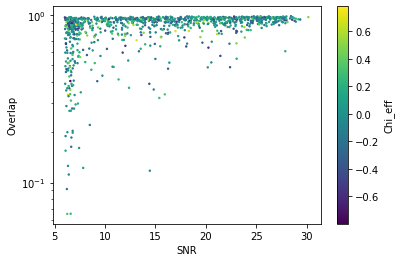

In [127]:
plt.scatter(snr[index], overlaps_10_30Hz_training[index], s=2, c=chi_eff[index], cmap='viridis')
plt.yscale('log')
plt.ylabel('Overlap')
plt.xlabel('SNR')

# Create colorbar and add label
cbar = plt.colorbar()
cbar.set_label('Chi_eff')

plt.savefig('Test_plots/Overlap_vs_SNR_chi_eff.png', dpi=200)


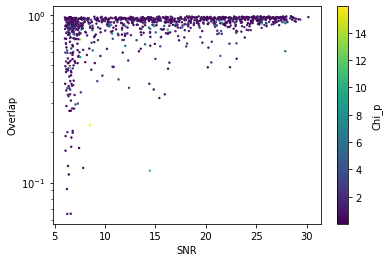

In [128]:
plt.scatter(snr[index], overlaps_10_30Hz_training[index], s=2, c=chi_p[index], cmap='viridis')
plt.yscale('log')
plt.ylabel('Overlap')
plt.xlabel('SNR')

# Create colorbar and add label
cbar = plt.colorbar()
cbar.set_label('Chi_p')

plt.savefig('Test_plots/Overlap_vs_SNR_chi_p.png', dpi=200)


# IMRPhenomXPHM

In [98]:
f1 = h5py.File('/fred/oz016/Chayan/samplegen_old/output/O3b_test_IMRPhenomXPHM_mass-20to30_snr-12_lm_all.hdf', 'r')
f2 = h5py.File('/fred/oz016/Chayan/samplegen_old/output/O3b_test_IMRPhenomXPHM_mass-20to30_snr-12_lm_22_21_32_33.hdf', 'r')
f3 = h5py.File('/fred/oz016/Chayan/samplegen_old/output/O3b_test_IMRPhenomXPHM_mass-20to30_snr-12_lm_22_21_32.hdf', 'r')
f4 = h5py.File('/fred/oz016/Chayan/samplegen_old/output/O3b_test_IMRPhenomXPHM_mass-20to30_snr-12_lm_22_21.hdf', 'r')
f5 = h5py.File('/fred/oz016/Chayan/samplegen_old/output/O3b_test_IMRPhenomXPHM_mass-20to30_snr-12_lm_22.hdf', 'r')

strain_1 = f1['injection_samples']['l1_strain'][()]
strain_2 = f2['injection_samples']['l1_strain'][()]
strain_3 = f3['injection_samples']['l1_strain'][()]
strain_4 = f4['injection_samples']['l1_strain'][()]
strain_5 = f5['injection_samples']['l1_strain'][()]

signal_1 = f1['injection_parameters']['l1_signal_whitened'][()]
signal_2 = f2['injection_parameters']['l1_signal_whitened'][()]
signal_3 = f3['injection_parameters']['l1_signal_whitened'][()]
signal_4 = f4['injection_parameters']['l1_signal_whitened'][()]
signal_5 = f5['injection_parameters']['l1_signal_whitened'][()]

psd_l1_1 = f1['injection_parameters']['psd_noise_l1'][()]
psd_l1_2 = f2['injection_parameters']['psd_noise_l1'][()]
psd_l1_3 = f3['injection_parameters']['psd_noise_l1'][()]
psd_l1_4 = f4['injection_parameters']['psd_noise_l1'][()]
psd_l1_5 = f5['injection_parameters']['psd_noise_l1'][()]

snr_1 = f1['injection_parameters']['l1_snr'][()]*f1['injection_parameters']['scale_factor'][()]
snr_2 = f2['injection_parameters']['l1_snr'][()]*f2['injection_parameters']['scale_factor'][()]
snr_3 = f3['injection_parameters']['l1_snr'][()]*f3['injection_parameters']['scale_factor'][()]
snr_4 = f4['injection_parameters']['l1_snr'][()]*f4['injection_parameters']['scale_factor'][()]
snr_5 = f5['injection_parameters']['l1_snr'][()]*f5['injection_parameters']['scale_factor'][()]

strain = np.concatenate([strain_5, strain_4, strain_3, strain_2, strain_1], axis=0)
signal = np.concatenate([signal_5, signal_4, signal_3, signal_2, signal_1], axis=0)
psd_l1 = np.concatenate([psd_l1_5, psd_l1_4, psd_l1_3, psd_l1_2, psd_l1_1], axis=0)
snr = np.concatenate([snr_1, snr_2, snr_3, snr_4, snr_5], axis=0)


In [99]:
strain, maximum, minimum = _preprocess_data(strain, strain.shape[0], 2048)
strain = np.array(strain)
strain.shape


(500, 2048)

In [100]:
X_test_strain = reshape_sequences(strain.shape[0], strain)
X_test_pure_signal = reshape_sequences(signal.shape[0], signal)

# Reshape arrays to fit into Keras model
X_test_strain = X_test_strain[:,:,:,None]
print('x_test_strain shape:', X_test_strain.shape)
X_test_strain = X_test_strain.astype("float32")

X_test_pure_signal = X_test_pure_signal[:,:,:,None]
print('x_test_pure_signal shape:', X_test_pure_signal.shape)
X_test_pure_signal = X_test_pure_signal.astype("float32")


x_test_strain shape: (500, 2058, 10, 1)
x_test_pure_signal shape: (500, 2058, 10, 1)


In [101]:
model = tf.keras.models.load_model('/fred/oz016/Chayan/GW-Denoiser/model/model_IMRPhenomXPHM_O3b_noise_10_timesteps_attention_30Hz_FT_loss_larger_model_mse_loss.h5', custom_objects={'FractalTanimotoLoss': FractalTanimotoLoss, 'AttentionLayer': AttentionLayer})


In [102]:
decoded_signals = model.predict(X_test_strain, batch_size=50)


In [103]:
from pycbc.filter import match, overlap
from pycbc.psd import aLIGOZeroDetHighPower
from pycbc.types.timeseries import TimeSeries, FrequencySeries
import matplotlib.pyplot as plt

overlaps = []

def get_overlap(decoded_signal, pure_signal, psd):
    
    time_buffer = 1
    length_signal = len(decoded_signal)

    f_low = 18
    sample_rate = 2048

    # Length of corresponding time series and frequency series
    tlen = sample_rate * time_buffer
    flen = tlen // 2 + 1

    delta_f = 1.0 / time_buffer
#    psd = aLIGOZeroDetHighPower(flen, delta_f, f_low)
    psd = FrequencySeries(psd, delta_f=delta_f)
    
    X_test_pure_ts = TimeSeries(pure_signal.squeeze(), delta_t = 1.0/2048)
    decoded_signals_ts = TimeSeries(decoded_signal.squeeze(), delta_t = 1.0/2048)

    X_test_pure_ts.resize(tlen)
    decoded_signals_ts.resize(tlen)

    m = Overlap_calc(X_test_pure_ts,decoded_signals_ts,psd)
    
    return m

for i in range(decoded_signals.shape[0]):
    overlaps.append(get_overlap(decoded_signals[i].astype('float64'), signal[i].astype('float64'), psd_l1[i]))
    

In [104]:
overlaps_IMRPhenomXPHM = np.array(overlaps)

lists = [overlaps_IMRPhenomXPHM[0:100],overlaps_IMRPhenomXPHM[100:200],overlaps_IMRPhenomXPHM[200:300],overlaps_IMRPhenomXPHM[300:400],overlaps_IMRPhenomXPHM[400:500]]


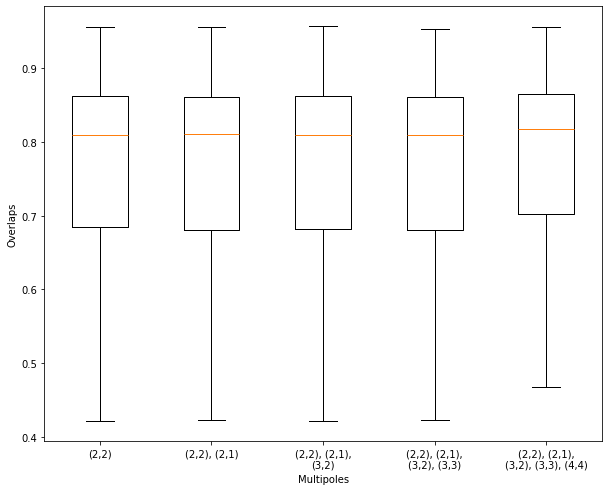

In [105]:
import matplotlib.pyplot as plt

# Assuming overlaps_IMRPhenomXPHM and lists are defined

plt.figure(figsize=(10, 8))  # Adjust the width and height as needed

plt.boxplot(lists, showfliers=False)
plt.xlabel('Multipoles')
plt.ylabel('Overlaps')
#plt.title('Box and Whiskers Plot')

# Splitting the labels into two lines and rotating them for better readability
plt.xticks(range(1, len(lists) + 1), 
           ['(2,2)', 
            '(2,2), (2,1)', 
            '(2,2), (2,1),\n(3,2)', 
            '(2,2), (2,1),\n(3,2), (3,3)', 
            '(2,2), (2,1),\n(3,2), (3,3), (4,4)'], 
           )  # Adjust the rotation angle as needed

plt.savefig('Test_plots/IMRPhenomXPHM_lm_modes.png', dpi=200)


# GW150914 - IMRPhenomXPHM

In [24]:
f1 = h5py.File('/fred/oz016/Chayan/samplegen_old/output/O3b_test_IMRPhenomXPHM_mass-GW150914_snr-35_lm_all.hdf', 'r')
f2 = h5py.File('/fred/oz016/Chayan/samplegen_old/output/O3b_test_IMRPhenomXPHM_mass-GW150914_snr-35_lm_22_21_32_33.hdf', 'r')
f3 = h5py.File('/fred/oz016/Chayan/samplegen_old/output/O3b_test_IMRPhenomXPHM_mass-GW150914_snr-35_lm_22_21_32.hdf', 'r')
f4 = h5py.File('/fred/oz016/Chayan/samplegen_old/output/O3b_test_IMRPhenomXPHM_mass-GW150914_snr-35_lm_22_21.hdf', 'r')
f5 = h5py.File('/fred/oz016/Chayan/samplegen_old/output/O3b_test_IMRPhenomXPHM_mass-GW150914_snr-35_lm_22.hdf', 'r')

strain_1 = f1['injection_samples']['l1_strain'][()]
strain_2 = f2['injection_samples']['l1_strain'][()]
strain_3 = f3['injection_samples']['l1_strain'][()]
strain_4 = f4['injection_samples']['l1_strain'][()]
strain_5 = f5['injection_samples']['l1_strain'][()]

signal_1 = f1['injection_parameters']['l1_signal_whitened'][()]
signal_2 = f2['injection_parameters']['l1_signal_whitened'][()]
signal_3 = f3['injection_parameters']['l1_signal_whitened'][()]
signal_4 = f4['injection_parameters']['l1_signal_whitened'][()]
signal_5 = f5['injection_parameters']['l1_signal_whitened'][()]

psd_l1_1 = f1['injection_parameters']['psd_noise_l1'][()]
psd_l1_2 = f2['injection_parameters']['psd_noise_l1'][()]
psd_l1_3 = f3['injection_parameters']['psd_noise_l1'][()]
psd_l1_4 = f4['injection_parameters']['psd_noise_l1'][()]
psd_l1_5 = f5['injection_parameters']['psd_noise_l1'][()]

snr_1 = f1['injection_parameters']['l1_snr'][()]*f1['injection_parameters']['scale_factor'][()]
snr_2 = f2['injection_parameters']['l1_snr'][()]*f2['injection_parameters']['scale_factor'][()]
snr_3 = f3['injection_parameters']['l1_snr'][()]*f3['injection_parameters']['scale_factor'][()]
snr_4 = f4['injection_parameters']['l1_snr'][()]*f4['injection_parameters']['scale_factor'][()]
snr_5 = f5['injection_parameters']['l1_snr'][()]*f5['injection_parameters']['scale_factor'][()]

strain = np.concatenate([strain_5, strain_4, strain_3, strain_2, strain_1], axis=0)
signal = np.concatenate([signal_5, signal_4, signal_3, signal_2, signal_1], axis=0)
psd_l1 = np.concatenate([psd_l1_5, psd_l1_4, psd_l1_3, psd_l1_2, psd_l1_1], axis=0)
snr = np.concatenate([snr_1, snr_2, snr_3, snr_4, snr_5], axis=0)


In [25]:
strain, maximum, minimum = _preprocess_data(strain, strain.shape[0], 2048)
strain = np.array(strain)
strain.shape


(500, 2048)

In [26]:
X_test_strain = reshape_sequences(strain.shape[0], strain)
X_test_pure_signal = reshape_sequences(signal.shape[0], signal)

# Reshape arrays to fit into Keras model
X_test_strain = X_test_strain[:,:,:,None]
print('x_test_strain shape:', X_test_strain.shape)
X_test_strain = X_test_strain.astype("float32")

X_test_pure_signal = X_test_pure_signal[:,:,:,None]
print('x_test_pure_signal shape:', X_test_pure_signal.shape)
X_test_pure_signal = X_test_pure_signal.astype("float32")


x_test_strain shape: (500, 2058, 10, 1)
x_test_pure_signal shape: (500, 2058, 10, 1)


In [27]:
model = tf.keras.models.load_model('/fred/oz016/Chayan/GW-Denoiser/model/model_IMRPhenomXPHM_O3b_noise_10_timesteps_attention_30Hz_FT_loss_larger_model_mse_loss.h5', custom_objects={'FractalTanimotoLoss': FractalTanimotoLoss, 'AttentionLayer': AttentionLayer})

decoded_signals = model.predict(X_test_strain, batch_size=50)


In [28]:
from pycbc.filter import match, overlap
from pycbc.psd import aLIGOZeroDetHighPower
from pycbc.types.timeseries import TimeSeries, FrequencySeries
import matplotlib.pyplot as plt

overlaps = []

def get_overlap(decoded_signal, pure_signal, psd):
    
    time_buffer = 1
    length_signal = len(decoded_signal)

    f_low = 18
    sample_rate = 2048

    # Length of corresponding time series and frequency series
    tlen = sample_rate * time_buffer
    flen = tlen // 2 + 1

    delta_f = 1.0 / time_buffer
#    psd = aLIGOZeroDetHighPower(flen, delta_f, f_low)
    psd = FrequencySeries(psd, delta_f=delta_f)
    
    X_test_pure_ts = TimeSeries(pure_signal.squeeze(), delta_t = 1.0/2048)
    decoded_signals_ts = TimeSeries(decoded_signal.squeeze(), delta_t = 1.0/2048)

    X_test_pure_ts.resize(tlen)
    decoded_signals_ts.resize(tlen)

    m = Overlap_calc(X_test_pure_ts,decoded_signals_ts,psd)
    
    return m

for i in range(decoded_signals.shape[0]):
    overlaps.append(get_overlap(decoded_signals[i].astype('float64'), signal[i].astype('float64'), psd_l1[i]))
    

In [29]:
overlaps_IMRPhenomXPHM = np.array(overlaps)

lists = [overlaps_IMRPhenomXPHM[0:100],overlaps_IMRPhenomXPHM[100:200],overlaps_IMRPhenomXPHM[200:300],overlaps_IMRPhenomXPHM[300:400],overlaps_IMRPhenomXPHM[400:500]]


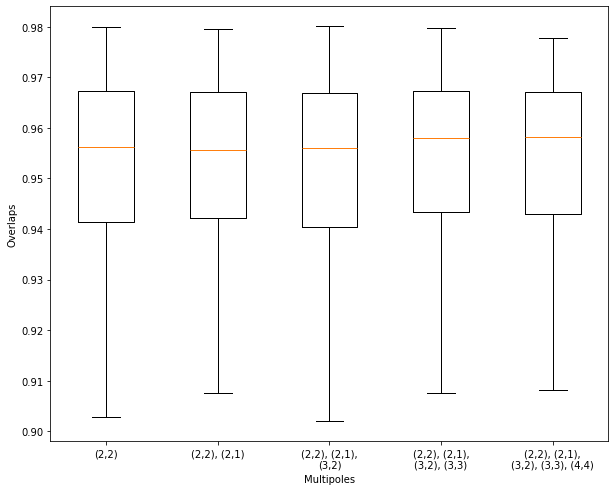

In [30]:
import matplotlib.pyplot as plt

# Assuming overlaps_IMRPhenomXPHM and lists are defined

plt.figure(figsize=(10, 8))  # Adjust the width and height as needed

plt.boxplot(lists, showfliers=False)
plt.xlabel('Multipoles')
plt.ylabel('Overlaps')
#plt.title('Box and Whiskers Plot')

# Splitting the labels into two lines and rotating them for better readability
plt.xticks(range(1, len(lists) + 1), 
           ['(2,2)', 
            '(2,2), (2,1)', 
            '(2,2), (2,1),\n(3,2)', 
            '(2,2), (2,1),\n(3,2), (3,3)', 
            '(2,2), (2,1),\n(3,2), (3,3), (4,4)'], 
           )  # Adjust the rotation angle as needed

plt.savefig('Test_plots/GW150914_IMRPhenomXPHM_lm_modes_overlaps.png', dpi=200)


In [31]:
snr_denoised = []
snr_pure = []

snr_frac = []

for i in range(decoded_signals.shape[0]):
    snr_denoised.append(get_snr_frac((decoded_signals[i].squeeze()).astype('float64')))
    snr_pure.append(get_snr_frac((signal[i]).astype('float64')))
    
snr_denoised = np.array(snr_denoised)
snr_pure = np.array(snr_pure)

snr_frac = snr_denoised/snr_pure


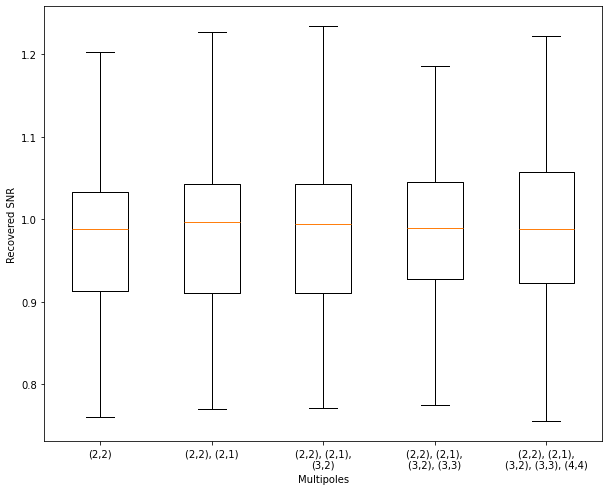

In [32]:
lists = [snr_frac[0:100],snr_frac[100:200],snr_frac[200:300],snr_frac[300:400],snr_frac[400:500]]

plt.figure(figsize=(10, 8))  # Adjust the width and height as needed

plt.boxplot(lists, showfliers=False)
plt.xlabel('Multipoles')
plt.ylabel('Recovered SNR fraction')
#plt.title('Box and Whiskers Plot')

# Splitting the labels into two lines and rotating them for better readability
plt.xticks(range(1, len(lists) + 1), 
           ['(2,2)', 
            '(2,2), (2,1)', 
            '(2,2), (2,1),\n(3,2)', 
            '(2,2), (2,1),\n(3,2), (3,3)', 
            '(2,2), (2,1),\n(3,2), (3,3), (4,4)'], 
           )  # Adjust the rotation angle as needed

plt.savefig('Test_plots/GW150914_IMRPhenomXPHM_lm_modes_recovered_SNR.png', dpi=200)


# GW190521 - IMRPhenomXPHM

In [33]:
f1 = h5py.File('/fred/oz016/Chayan/samplegen_old/output/O3b_test_IMRPhenomXPHM_mass-GW190521_snr-35_lm_all.hdf', 'r')
f2 = h5py.File('/fred/oz016/Chayan/samplegen_old/output/O3b_test_IMRPhenomXPHM_mass-GW190521_snr-35_lm_22_21_32_33.hdf', 'r')
f3 = h5py.File('/fred/oz016/Chayan/samplegen_old/output/O3b_test_IMRPhenomXPHM_mass-GW190521_snr-35_lm_22_21_32.hdf', 'r')
f4 = h5py.File('/fred/oz016/Chayan/samplegen_old/output/O3b_test_IMRPhenomXPHM_mass-GW190521_snr-35_lm_22_21.hdf', 'r')
f5 = h5py.File('/fred/oz016/Chayan/samplegen_old/output/O3b_test_IMRPhenomXPHM_mass-GW190521_snr-35_lm_22.hdf', 'r')

strain_1 = f1['injection_samples']['l1_strain'][()]
strain_2 = f2['injection_samples']['l1_strain'][()]
strain_3 = f3['injection_samples']['l1_strain'][()]
strain_4 = f4['injection_samples']['l1_strain'][()]
strain_5 = f5['injection_samples']['l1_strain'][()]

signal_1 = f1['injection_parameters']['l1_signal_whitened'][()]
signal_2 = f2['injection_parameters']['l1_signal_whitened'][()]
signal_3 = f3['injection_parameters']['l1_signal_whitened'][()]
signal_4 = f4['injection_parameters']['l1_signal_whitened'][()]
signal_5 = f5['injection_parameters']['l1_signal_whitened'][()]

psd_l1_1 = f1['injection_parameters']['psd_noise_l1'][()]
psd_l1_2 = f2['injection_parameters']['psd_noise_l1'][()]
psd_l1_3 = f3['injection_parameters']['psd_noise_l1'][()]
psd_l1_4 = f4['injection_parameters']['psd_noise_l1'][()]
psd_l1_5 = f5['injection_parameters']['psd_noise_l1'][()]

snr_1 = f1['injection_parameters']['l1_snr'][()]*f1['injection_parameters']['scale_factor'][()]
snr_2 = f2['injection_parameters']['l1_snr'][()]*f2['injection_parameters']['scale_factor'][()]
snr_3 = f3['injection_parameters']['l1_snr'][()]*f3['injection_parameters']['scale_factor'][()]
snr_4 = f4['injection_parameters']['l1_snr'][()]*f4['injection_parameters']['scale_factor'][()]
snr_5 = f5['injection_parameters']['l1_snr'][()]*f5['injection_parameters']['scale_factor'][()]

strain = np.concatenate([strain_5, strain_4, strain_3, strain_2, strain_1], axis=0)
signal = np.concatenate([signal_5, signal_4, signal_3, signal_2, signal_1], axis=0)
psd_l1 = np.concatenate([psd_l1_5, psd_l1_4, psd_l1_3, psd_l1_2, psd_l1_1], axis=0)
snr = np.concatenate([snr_1, snr_2, snr_3, snr_4, snr_5], axis=0)


In [34]:
strain, maximum, minimum = _preprocess_data(strain, strain.shape[0], 2048)
strain = np.array(strain)
strain.shape


(500, 2048)

In [35]:
X_test_strain = reshape_sequences(strain.shape[0], strain)
X_test_pure_signal = reshape_sequences(signal.shape[0], signal)

# Reshape arrays to fit into Keras model
X_test_strain = X_test_strain[:,:,:,None]
print('x_test_strain shape:', X_test_strain.shape)
X_test_strain = X_test_strain.astype("float32")

X_test_pure_signal = X_test_pure_signal[:,:,:,None]
print('x_test_pure_signal shape:', X_test_pure_signal.shape)
X_test_pure_signal = X_test_pure_signal.astype("float32")


x_test_strain shape: (500, 2058, 10, 1)
x_test_pure_signal shape: (500, 2058, 10, 1)


In [36]:
model = tf.keras.models.load_model('/fred/oz016/Chayan/GW-Denoiser/model/model_IMRPhenomXPHM_O3b_noise_10_timesteps_attention_30Hz_FT_loss_larger_model_mse_loss.h5', custom_objects={'FractalTanimotoLoss': FractalTanimotoLoss, 'AttentionLayer': AttentionLayer})

decoded_signals = model.predict(X_test_strain, batch_size=50)


In [37]:
from pycbc.filter import match, overlap
from pycbc.psd import aLIGOZeroDetHighPower
from pycbc.types.timeseries import TimeSeries, FrequencySeries
import matplotlib.pyplot as plt

overlaps = []

def get_overlap(decoded_signal, pure_signal, psd):
    
    time_buffer = 1
    length_signal = len(decoded_signal)

    f_low = 18
    sample_rate = 2048

    # Length of corresponding time series and frequency series
    tlen = sample_rate * time_buffer
    flen = tlen // 2 + 1

    delta_f = 1.0 / time_buffer
#    psd = aLIGOZeroDetHighPower(flen, delta_f, f_low)
    psd = FrequencySeries(psd, delta_f=delta_f)
    
    X_test_pure_ts = TimeSeries(pure_signal.squeeze(), delta_t = 1.0/2048)
    decoded_signals_ts = TimeSeries(decoded_signal.squeeze(), delta_t = 1.0/2048)

    X_test_pure_ts.resize(tlen)
    decoded_signals_ts.resize(tlen)

    m = Overlap_calc(X_test_pure_ts,decoded_signals_ts,psd)
    
    return m

for i in range(decoded_signals.shape[0]):
    overlaps.append(get_overlap(decoded_signals[i].astype('float64'), signal[i].astype('float64'), psd_l1[i]))
    

In [38]:
overlaps_IMRPhenomXPHM = np.array(overlaps)

lists = [overlaps_IMRPhenomXPHM[0:100],overlaps_IMRPhenomXPHM[100:200],overlaps_IMRPhenomXPHM[200:300],overlaps_IMRPhenomXPHM[300:400],overlaps_IMRPhenomXPHM[400:500]]


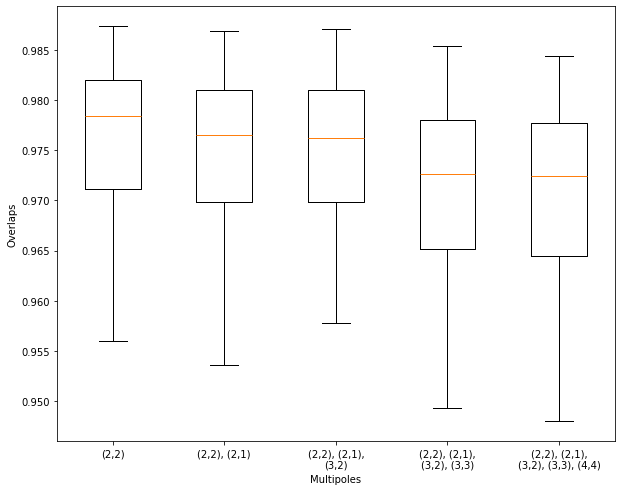

In [39]:
import matplotlib.pyplot as plt

# Assuming overlaps_IMRPhenomXPHM and lists are defined

plt.figure(figsize=(10, 8))  # Adjust the width and height as needed

plt.boxplot(lists, showfliers=False)
plt.xlabel('Multipoles')
plt.ylabel('Overlaps')
#plt.title('Box and Whiskers Plot')

# Splitting the labels into two lines and rotating them for better readability
plt.xticks(range(1, len(lists) + 1), 
           ['(2,2)', 
            '(2,2), (2,1)', 
            '(2,2), (2,1),\n(3,2)', 
            '(2,2), (2,1),\n(3,2), (3,3)', 
            '(2,2), (2,1),\n(3,2), (3,3), (4,4)'], 
           )  # Adjust the rotation angle as needed

plt.savefig('Test_plots/GW190521_IMRPhenomXPHM_lm_modes_overlaps.png', dpi=200)


In [40]:
snr_denoised = []
snr_pure = []

snr_frac = []

for i in range(decoded_signals.shape[0]):
    snr_denoised.append(get_snr_frac((decoded_signals[i].squeeze()).astype('float64')))
    snr_pure.append(get_snr_frac((signal[i]).astype('float64')))
    
snr_denoised = np.array(snr_denoised)
snr_pure = np.array(snr_pure)

snr_frac = snr_denoised/snr_pure


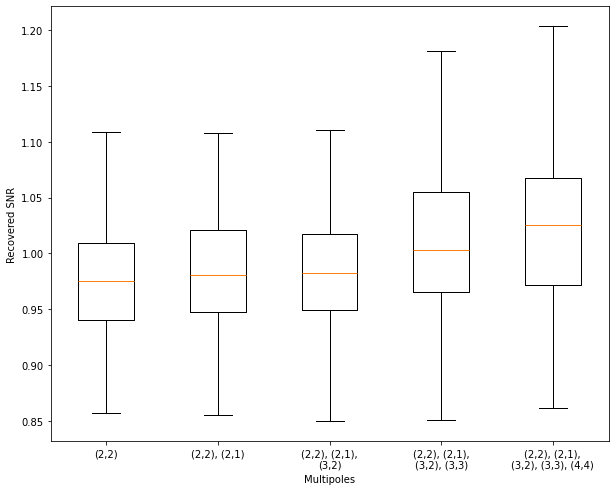

In [41]:
lists = [snr_frac[0:100],snr_frac[100:200],snr_frac[200:300],snr_frac[300:400],snr_frac[400:500]]

plt.figure(figsize=(10, 8))  # Adjust the width and height as needed

plt.boxplot(lists, showfliers=False)
plt.xlabel('Multipoles')
plt.ylabel('Recovered SNR fraction')
#plt.title('Box and Whiskers Plot')

# Splitting the labels into two lines and rotating them for better readability
plt.xticks(range(1, len(lists) + 1), 
           ['(2,2)', 
            '(2,2), (2,1)', 
            '(2,2), (2,1),\n(3,2)', 
            '(2,2), (2,1),\n(3,2), (3,3)', 
            '(2,2), (2,1),\n(3,2), (3,3), (4,4)'], 
           )  # Adjust the rotation angle as needed

plt.savefig('Test_plots/GW190521_IMRPhenomXPHM_lm_modes_recovered_SNR.png', dpi=200)


# GW190412 - IMRPhenomXPHM

In [13]:
f1 = h5py.File('/fred/oz016/Chayan/samplegen_old/output/O3b_test_IMRPhenomXPHM_mass-GW190412_snr-20_lm_all.hdf', 'r')
f2 = h5py.File('/fred/oz016/Chayan/samplegen_old/output/O3b_test_IMRPhenomXPHM_mass-GW190412_snr-20_lm_22_21_32_33.hdf', 'r')
f3 = h5py.File('/fred/oz016/Chayan/samplegen_old/output/O3b_test_IMRPhenomXPHM_mass-GW190412_snr-20_lm_22_21_32.hdf', 'r')
f4 = h5py.File('/fred/oz016/Chayan/samplegen_old/output/O3b_test_IMRPhenomXPHM_mass-GW190412_snr-20_lm_22_21.hdf', 'r')
f5 = h5py.File('/fred/oz016/Chayan/samplegen_old/output/O3b_test_IMRPhenomXPHM_mass-GW190412_snr-20_lm_22.hdf', 'r')

strain_1 = f1['injection_samples']['l1_strain'][()]
strain_2 = f2['injection_samples']['l1_strain'][()]
strain_3 = f3['injection_samples']['l1_strain'][()]
strain_4 = f4['injection_samples']['l1_strain'][()]
strain_5 = f5['injection_samples']['l1_strain'][()]

signal_1 = f1['injection_parameters']['l1_signal_whitened'][()]
signal_2 = f2['injection_parameters']['l1_signal_whitened'][()]
signal_3 = f3['injection_parameters']['l1_signal_whitened'][()]
signal_4 = f4['injection_parameters']['l1_signal_whitened'][()]
signal_5 = f5['injection_parameters']['l1_signal_whitened'][()]

psd_l1_1 = f1['injection_parameters']['psd_noise_l1'][()]
psd_l1_2 = f2['injection_parameters']['psd_noise_l1'][()]
psd_l1_3 = f3['injection_parameters']['psd_noise_l1'][()]
psd_l1_4 = f4['injection_parameters']['psd_noise_l1'][()]
psd_l1_5 = f5['injection_parameters']['psd_noise_l1'][()]

snr_1 = f1['injection_parameters']['l1_snr'][()]*f1['injection_parameters']['scale_factor'][()]
snr_2 = f2['injection_parameters']['l1_snr'][()]*f2['injection_parameters']['scale_factor'][()]
snr_3 = f3['injection_parameters']['l1_snr'][()]*f3['injection_parameters']['scale_factor'][()]
snr_4 = f4['injection_parameters']['l1_snr'][()]*f4['injection_parameters']['scale_factor'][()]
snr_5 = f5['injection_parameters']['l1_snr'][()]*f5['injection_parameters']['scale_factor'][()]

strain = np.concatenate([strain_5, strain_4, strain_3, strain_2, strain_1], axis=0)
signal = np.concatenate([signal_5, signal_4, signal_3, signal_2, signal_1], axis=0)
psd_l1 = np.concatenate([psd_l1_5, psd_l1_4, psd_l1_3, psd_l1_2, psd_l1_1], axis=0)
snr = np.concatenate([snr_1, snr_2, snr_3, snr_4, snr_5], axis=0)


In [14]:
strain, maximum, minimum = _preprocess_data(strain, strain.shape[0], 2048)
strain = np.array(strain)
strain.shape


(500, 2048)

In [15]:
X_test_strain = reshape_sequences(strain.shape[0], strain)
X_test_pure_signal = reshape_sequences(signal.shape[0], signal)

# Reshape arrays to fit into Keras model
X_test_strain = X_test_strain[:,:,:,None]
print('x_test_strain shape:', X_test_strain.shape)
X_test_strain = X_test_strain.astype("float32")

X_test_pure_signal = X_test_pure_signal[:,:,:,None]
print('x_test_pure_signal shape:', X_test_pure_signal.shape)
X_test_pure_signal = X_test_pure_signal.astype("float32")


x_test_strain shape: (500, 2058, 10, 1)
x_test_pure_signal shape: (500, 2058, 10, 1)


In [16]:
model = tf.keras.models.load_model('/fred/oz016/Chayan/GW-Denoiser/model/model_IMRPhenomXPHM_O3b_noise_10_timesteps_attention_30Hz_FT_loss_larger_model_mse_loss.h5', custom_objects={'FractalTanimotoLoss': FractalTanimotoLoss, 'AttentionLayer': AttentionLayer})

decoded_signals = model.predict(X_test_strain, batch_size=50)


In [17]:
from pycbc.filter import match, overlap
from pycbc.psd import aLIGOZeroDetHighPower
from pycbc.types.timeseries import TimeSeries, FrequencySeries
import matplotlib.pyplot as plt

overlaps = []

def get_overlap(decoded_signal, pure_signal, psd):
    
    time_buffer = 1
    length_signal = len(decoded_signal)

    f_low = 18
    sample_rate = 2048

    # Length of corresponding time series and frequency series
    tlen = sample_rate * time_buffer
    flen = tlen // 2 + 1

    delta_f = 1.0 / time_buffer
#    psd = aLIGOZeroDetHighPower(flen, delta_f, f_low)
    psd = FrequencySeries(psd, delta_f=delta_f)
    
    X_test_pure_ts = TimeSeries(pure_signal.squeeze(), delta_t = 1.0/2048)
    decoded_signals_ts = TimeSeries(decoded_signal.squeeze(), delta_t = 1.0/2048)

    X_test_pure_ts.resize(tlen)
    decoded_signals_ts.resize(tlen)

    m = Overlap_calc(X_test_pure_ts,decoded_signals_ts,psd)
    
    return m

for i in range(decoded_signals.shape[0]):
    overlaps.append(get_overlap(decoded_signals[i].astype('float64'), signal[i].astype('float64'), psd_l1[i]))
    

In [18]:
overlaps_IMRPhenomXPHM = np.array(overlaps)

lists = [overlaps_IMRPhenomXPHM[0:100],overlaps_IMRPhenomXPHM[100:200],overlaps_IMRPhenomXPHM[200:300],overlaps_IMRPhenomXPHM[300:400],overlaps_IMRPhenomXPHM[400:500]]


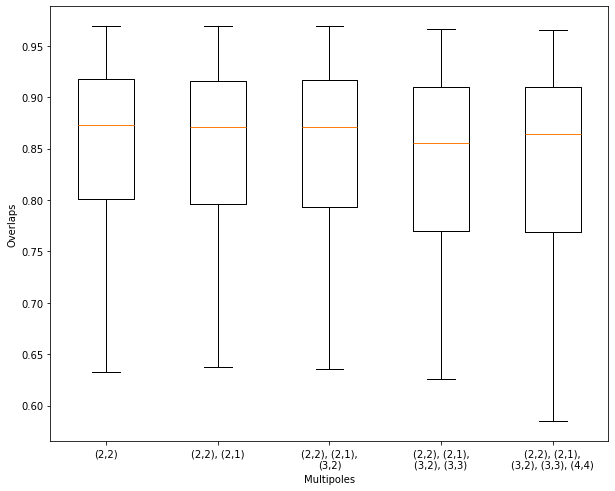

In [19]:
import matplotlib.pyplot as plt

# Assuming overlaps_IMRPhenomXPHM and lists are defined

plt.figure(figsize=(10, 8))  # Adjust the width and height as needed

plt.boxplot(lists, showfliers=False)
plt.xlabel('Multipoles')
plt.ylabel('Overlaps')
#plt.title('Box and Whiskers Plot')

# Splitting the labels into two lines and rotating them for better readability
plt.xticks(range(1, len(lists) + 1), 
           ['(2,2)', 
            '(2,2), (2,1)', 
            '(2,2), (2,1),\n(3,2)', 
            '(2,2), (2,1),\n(3,2), (3,3)', 
            '(2,2), (2,1),\n(3,2), (3,3), (4,4)'], 
           )  # Adjust the rotation angle as needed

plt.savefig('Test_plots/GW190412_IMRPhenomXPHM_lm_modes_overlaps.png', dpi=200)


In [21]:
snr_denoised = []
snr_pure = []

snr_frac = []

for i in range(decoded_signals.shape[0]):
    snr_denoised.append(get_snr_frac((decoded_signals[i].squeeze()).astype('float64')))
    snr_pure.append(get_snr_frac((signal[i]).astype('float64')))
    
snr_denoised = np.array(snr_denoised)
snr_pure = np.array(snr_pure)

snr_frac = snr_denoised/snr_pure


In [ ]:
lists = [snr_frac[0:100],snr_frac[100:200],snr_frac[200:300],snr_frac[300:400],snr_frac[400:500]]

plt.figure(figsize=(10, 8))  # Adjust the width and height as needed

plt.boxplot(lists, showfliers=False)
plt.xlabel('Multipoles')
plt.ylabel('Recovered SNR fraction')
#plt.title('Box and Whiskers Plot')

# Splitting the labels into two lines and rotating them for better readability
plt.xticks(range(1, len(lists) + 1), 
           ['(2,2)', 
            '(2,2), (2,1)', 
            '(2,2), (2,1),\n(3,2)', 
            '(2,2), (2,1),\n(3,2), (3,3)', 
            '(2,2), (2,1),\n(3,2), (3,3), (4,4)'], 
           )  # Adjust the rotation angle as needed

plt.savefig('Test_plots/GW190412_IMRPhenomXPHM_lm_modes_recovered_SNR.png', dpi=200)


# IMRPhenomPv3HM

In [45]:
f1 = h5py.File('/fred/oz016/Chayan/samplegen_old/output/O3b_test_IMRPhenomPv3HM_mass-20to30_snr-12_lm_all.hdf', 'r')
f2 = h5py.File('/fred/oz016/Chayan/samplegen_old/output/O3b_test_IMRPhenomPv3HM_mass-20to30_snr-12_lm_22_21_33_32_43.hdf', 'r')
f3 = h5py.File('/fred/oz016/Chayan/samplegen_old/output/O3b_test_IMRPhenomPv3HM_mass-20to30_snr-12_lm_22_21_32_33.hdf', 'r')
f4 = h5py.File('/fred/oz016/Chayan/samplegen_old/output/O3b_test_IMRPhenomPv3HM_mass-20to30_snr-12_lm_22_21_32.hdf', 'r')
f5 = h5py.File('/fred/oz016/Chayan/samplegen_old/output/O3b_test_IMRPhenomPv3HM_mass-20to30_snr-12_lm_22_21.hdf', 'r')
f6 = h5py.File('/fred/oz016/Chayan/samplegen_old/output/O3b_test_IMRPhenomPv3HM_mass-20to30_snr-12_lm_22.hdf', 'r')

strain_1 = f1['injection_samples']['l1_strain'][()]
strain_2 = f2['injection_samples']['l1_strain'][()]
strain_3 = f3['injection_samples']['l1_strain'][()]
strain_4 = f4['injection_samples']['l1_strain'][()]
strain_5 = f5['injection_samples']['l1_strain'][()]
strain_6 = f6['injection_samples']['l1_strain'][()]

signal_1 = f1['injection_parameters']['l1_signal_whitened'][()]
signal_2 = f2['injection_parameters']['l1_signal_whitened'][()]
signal_3 = f3['injection_parameters']['l1_signal_whitened'][()]
signal_4 = f4['injection_parameters']['l1_signal_whitened'][()]
signal_5 = f5['injection_parameters']['l1_signal_whitened'][()]
signal_6 = f6['injection_parameters']['l1_signal_whitened'][()]

psd_l1_1 = f1['injection_parameters']['psd_noise_l1'][()]
psd_l1_2 = f2['injection_parameters']['psd_noise_l1'][()]
psd_l1_3 = f3['injection_parameters']['psd_noise_l1'][()]
psd_l1_4 = f4['injection_parameters']['psd_noise_l1'][()]
psd_l1_5 = f5['injection_parameters']['psd_noise_l1'][()]
psd_l1_6 = f6['injection_parameters']['psd_noise_l1'][()]

strain = np.concatenate([strain_6, strain_5, strain_4, strain_3, strain_2, strain_1], axis=0)
signal = np.concatenate([signal_6, signal_5, signal_4, signal_3, signal_2, signal_1], axis=0)
psd_l1 = np.concatenate([psd_l1_6, psd_l1_5, psd_l1_4, psd_l1_3, psd_l1_2, psd_l1_1], axis=0)


In [46]:
strain, maximum, minimum = _preprocess_data(strain, strain.shape[0], 2048)
strain = np.array(strain)
strain.shape


(600, 2048)

In [47]:
X_test_strain = reshape_sequences(strain.shape[0], strain)
X_test_pure_signal = reshape_sequences(signal.shape[0], signal)

# Reshape arrays to fit into Keras model
X_test_strain = X_test_strain[:,:,:,None]
print('x_test_strain shape:', X_test_strain.shape)
X_test_strain = X_test_strain.astype("float32")

X_test_pure_signal = X_test_pure_signal[:,:,:,None]
print('x_test_pure_signal shape:', X_test_pure_signal.shape)
X_test_pure_signal = X_test_pure_signal.astype("float32")


x_test_strain shape: (600, 2058, 10, 1)
x_test_pure_signal shape: (600, 2058, 10, 1)


In [48]:
decoded_signals = model.predict(X_test_strain, batch_size=50)


In [49]:
for i in range(decoded_signals.shape[0]):
    overlaps.append(get_overlap(decoded_signals[i].astype('float64'), signal[i].astype('float64'), psd_l1[i]))


In [50]:
overlaps_IMRPhenomPv3HM = np.array(overlaps)

lists = [overlaps_IMRPhenomPv3HM[0:100],overlaps_IMRPhenomPv3HM[100:200],overlaps_IMRPhenomPv3HM[200:300],overlaps_IMRPhenomPv3HM[300:400],overlaps_IMRPhenomPv3HM[400:500], overlaps_IMRPhenomPv3HM[500:600]]


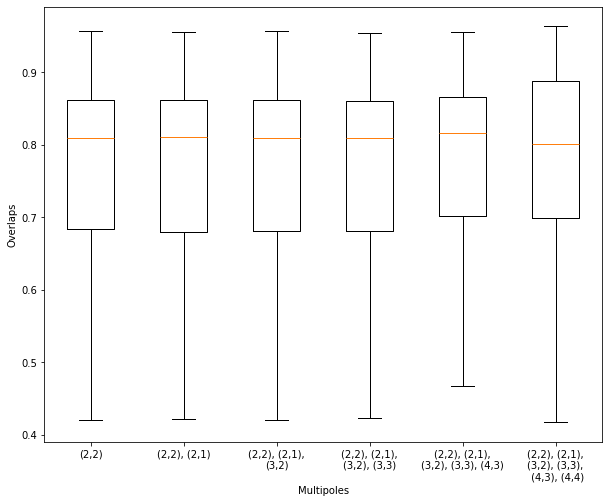

In [53]:
import matplotlib.pyplot as plt

# Assuming overlaps_IMRPhenomXPHM and lists are defined

plt.figure(figsize=(10, 8))  # Adjust the width and height as needed

plt.boxplot(lists, showfliers=False)
plt.xlabel('Multipoles')
plt.ylabel('Overlaps')
#plt.title('Box and Whiskers Plot')

# Splitting the labels into two lines and rotating them for better readability
plt.xticks(range(1, len(lists) + 1), 
           ['(2,2)', 
            '(2,2), (2,1)', 
            '(2,2), (2,1),\n(3,2)', 
            '(2,2), (2,1),\n(3,2), (3,3)', 
            '(2,2), (2,1),\n(3,2), (3,3), (4,3)',
            '(2,2), (2,1),\n(3,2), (3,3),\n (4,3), (4,4)'], 
           )  # Adjust the rotation angle as needed

plt.savefig('Test_plots/IMRPhenomPv3HM_lm_modes.png', dpi=200)


# SEOBNRv4PHM

In [54]:
f1 = h5py.File('/fred/oz016/Chayan/samplegen_old/output/O3b_test_SEOBNRv4PHM_mass-20to30_snr-12_lm_all.hdf', 'r')
f2 = h5py.File('/fred/oz016/Chayan/samplegen_old/output/O3b_test_SEOBNRv4PHM_mass-20to30_snr-12_lm_22_21_33_44.hdf', 'r')
f3 = h5py.File('/fred/oz016/Chayan/samplegen_old/output/O3b_test_SEOBNRv4PHM_mass-20to30_snr-12_lm_22_21_33.hdf', 'r')
f4 = h5py.File('/fred/oz016/Chayan/samplegen_old/output/O3b_test_SEOBNRv4PHM_mass-20to30_snr-12_lm_22_21.hdf', 'r')
f5 = h5py.File('/fred/oz016/Chayan/samplegen_old/output/O3b_test_SEOBNRv4PHM_mass-20to30_snr-12_lm_22.hdf', 'r')

strain_1 = f1['injection_samples']['l1_strain'][()]
strain_2 = f2['injection_samples']['l1_strain'][()]
strain_3 = f3['injection_samples']['l1_strain'][()]
strain_4 = f4['injection_samples']['l1_strain'][()]
strain_5 = f5['injection_samples']['l1_strain'][()]

signal_1 = f1['injection_parameters']['l1_signal_whitened'][()]
signal_2 = f2['injection_parameters']['l1_signal_whitened'][()]
signal_3 = f3['injection_parameters']['l1_signal_whitened'][()]
signal_4 = f4['injection_parameters']['l1_signal_whitened'][()]
signal_5 = f5['injection_parameters']['l1_signal_whitened'][()]

psd_l1_1 = f1['injection_parameters']['psd_noise_l1'][()]
psd_l1_2 = f2['injection_parameters']['psd_noise_l1'][()]
psd_l1_3 = f3['injection_parameters']['psd_noise_l1'][()]
psd_l1_4 = f4['injection_parameters']['psd_noise_l1'][()]
psd_l1_5 = f5['injection_parameters']['psd_noise_l1'][()]

strain = np.concatenate([strain_5, strain_4, strain_3, strain_2, strain_1], axis=0)
signal = np.concatenate([signal_5, signal_4, signal_3, signal_2, signal_1], axis=0)
psd_l1 = np.concatenate([psd_l1_5, psd_l1_4, psd_l1_3, psd_l1_2, psd_l1_1], axis=0)


In [55]:
strain = strain[:,::2]
signal = signal[:,::2]

In [56]:
strain, maximum, minimum = _preprocess_data(strain, strain.shape[0], 2048)
strain = np.array(strain)
strain.shape


(500, 2048)

In [57]:
X_test_strain = reshape_sequences(strain.shape[0], strain)
X_test_pure_signal = reshape_sequences(signal.shape[0], signal)

# Reshape arrays to fit into Keras model
X_test_strain = X_test_strain[:,:,:,None]
print('x_test_strain shape:', X_test_strain.shape)
X_test_strain = X_test_strain.astype("float32")

X_test_pure_signal = X_test_pure_signal[:,:,:,None]
print('x_test_pure_signal shape:', X_test_pure_signal.shape)
X_test_pure_signal = X_test_pure_signal.astype("float32")


x_test_strain shape: (500, 2058, 10, 1)
x_test_pure_signal shape: (500, 2058, 10, 1)


In [58]:
decoded_signals = model.predict(X_test_strain, batch_size=50)


In [ ]:
for i in range(decoded_signals.shape[0]):
    overlaps.append(get_overlap(decoded_signals[i].astype('float64'), signal[i].astype('float64'), psd_l1[i]))


In [ ]:
overlaps_SEOBNRv4PHM = np.array(overlaps)

lists = [overlaps_SEOBNRv4PHM[0:100],overlaps_SEOBNRv4PHM[100:200],overlaps_SEOBNRv4PHM[200:300],overlaps_SEOBNRv4PHM[300:400],overlaps_SEOBNRv4PHM[400:500]]


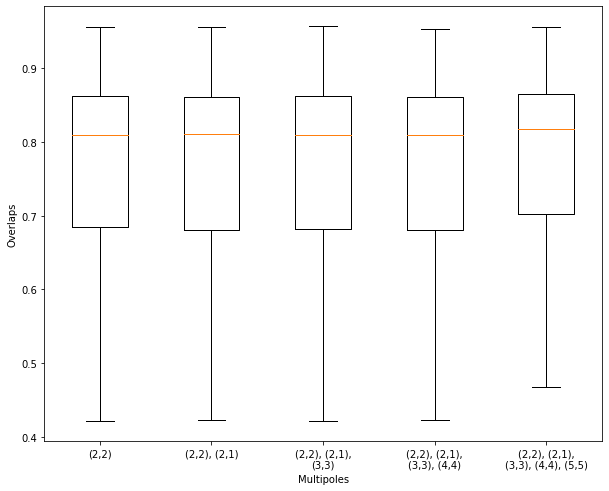

In [60]:
import matplotlib.pyplot as plt

# Assuming overlaps_IMRPhenomXPHM and lists are defined

plt.figure(figsize=(10, 8))  # Adjust the width and height as needed

plt.boxplot(lists, showfliers=False)
plt.xlabel('Multipoles')
plt.ylabel('Overlaps')
#plt.title('Box and Whiskers Plot')

# Splitting the labels into two lines and rotating them for better readability
plt.xticks(range(1, len(lists) + 1), 
           ['(2,2)', 
            '(2,2), (2,1)', 
            '(2,2), (2,1),\n(3,3)', 
            '(2,2), (2,1),\n(3,3), (4,4)', 
            '(2,2), (2,1),\n(3,3), (4,4), (5,5)'], 
           )  # Adjust the rotation angle as needed

plt.savefig('Test_plots/SEOBNRv4PHM_lm_modes.png', dpi=200)


# (l,m) = all

In [34]:
f1 = h5py.File('/fred/oz016/Chayan/samplegen_old/output/O3b_test_IMRPhenomXPHM_SNR-20to30_lm_all.hdf', 'r')

strain = f1['injection_samples']['l1_strain'][()]
noise = f1['noise_samples']['l1_strain'][()]

pure_signal = f1['injection_parameters']['l1_signal_whitened'][()]
pure_noise = f1['noise_parameters']['l1_signal_whitened'][()]

strain, maximum, minimum = _preprocess_data(strain, 50, 2048)
strain = np.array(strain)
strain.shape

noise, maximum, minimum = _preprocess_data(noise, 5, 2048)
noise = np.array(noise)
noise.shape

X_test_strain = reshape_sequences(50, strain)
X_test_noise = reshape_sequences(5, noise)

X_test_pure_signal = reshape_sequences(50, pure_signal)
X_test_pure_noise = reshape_sequences(5, pure_noise)

# Reshape arrays to fit into Keras model
X_test_strain = X_test_strain[:,:,:,None]
X_test_strain = X_test_strain.astype("float32")

X_test_noise = X_test_noise[:,:,:,None]
X_test_noise = X_test_noise.astype("float32")

X_test_pure_signal = X_test_pure_signal[:,:,:,None]
X_test_pure_signal = X_test_pure_signal.astype("float32")

X_test_pure_noise = X_test_pure_noise[:,:,:,None]
X_test_pure_noise = X_test_pure_noise.astype("float32")


In [35]:
#from keras.models import load_model

#model = tf.keras.models.load_model('/fred/oz016/Chayan/GW-Denoiser/model/model_IMRPhenomXPHM_O3b_noise_old_model_10_timesteps_mchirp_geq_10.h5', custom_objects={'FractalTanimotoLoss': FractalTanimotoLoss})

model = tf.keras.models.load_model('/fred/oz016/Chayan/GW-Denoiser/model/trained_model_test_IMBH_HM_O3b_noise_mass_corrected.h5', custom_objects={'FractalTanimotoLoss': FractalTanimotoLoss})
 
# load model
#model = tf.keras.models.load_model('/fred/oz016/Chayan/GW-Denoiser/model/model_IMRPhenomXPHM_O3b_noise_dilated_CNN_25_timesteps.h5', custom_objects={'FractalTanimotoLoss': FractalTanimotoLoss})


In [36]:
decoded_signals = model.predict(X_test_strain, batch_size=25)
decoded_signals_pure_noise = model.predict(X_test_noise, batch_size=25)


<ipython-input-29-f5335e0d8b93>:35: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(10,5))


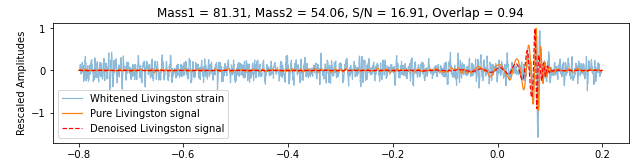

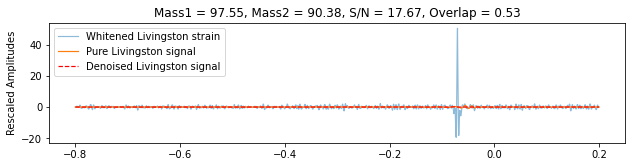

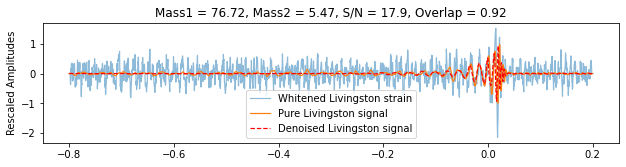

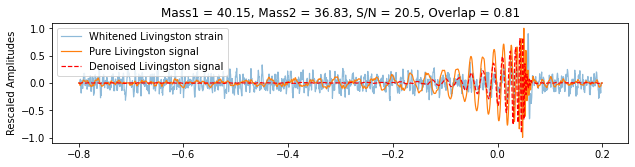

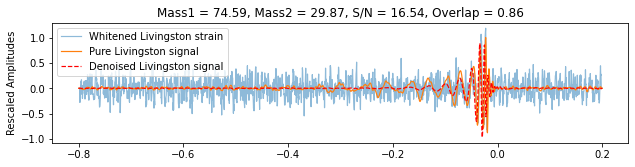

...

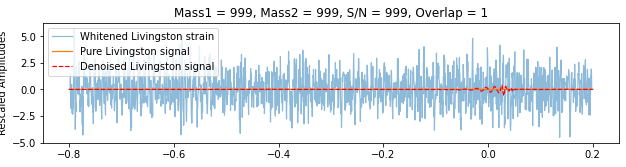

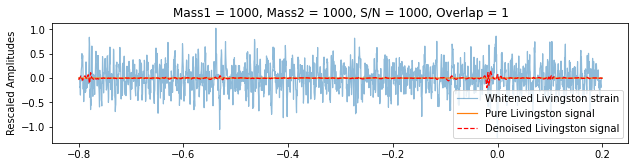

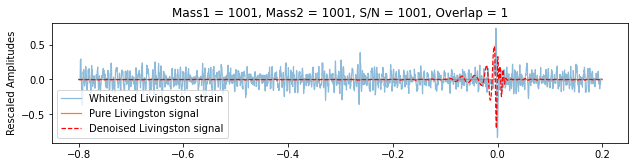

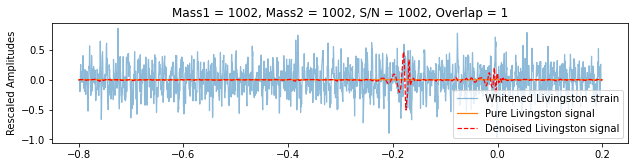

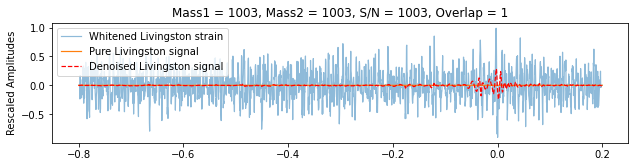

In [37]:
overlaps_10_all = []

for i in range(50):
    pure_signals = np.pad(f1['injection_parameters']['l1_signal_whitened'][i].astype(np.float64), (5,5), constant_values=(0,0))   
    strain = np.pad(f1['injection_samples']['l1_strain'][i].astype(np.float64), (5,5), constant_values=(0,0))
    psd = f1['injection_parameters']['psd_noise_l1'][i].astype(np.float64)
    
    m1 = f1['injection_parameters']['mass1'][i]
    m2 = f1['injection_parameters']['mass2'][i]
    snr = f1['injection_parameters']['l1_snr'][i]*f1['injection_parameters']['scale_factor'][i]
    
    overlaps_10_all.append(plot_reconstructed(decoded_signals[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr, psd))


for i in range(5):
    
    pure_signals = np.pad(f1['noise_parameters']['l1_signal_whitened'][i].astype(np.float64), (5,5), constant_values=(0,0))     
    strain = np.pad(f1['noise_samples']['l1_strain'][i].astype(np.float64), (5,5), constant_values=(0,0))
    
    m1 = 999 + i
    m2 = 999 + i
    snr = 999 + i
        
    plot_reconstructed(decoded_signals_pure_noise[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr, psd)
    

# (l,m) = (2,2), (3,3)

In [38]:
f1 = h5py.File('/fred/oz016/Chayan/samplegen_old/output/O3b_test_IMRPhenomXPHM_SNR-20to30_lm_22_33.hdf', 'r')

strain = f1['injection_samples']['l1_strain'][()]
noise = f1['noise_samples']['l1_strain'][()]

pure_signal = f1['injection_parameters']['l1_signal_whitened'][()]
pure_noise = f1['noise_parameters']['l1_signal_whitened'][()]

strain, maximum, minimum = _preprocess_data(strain, 50, 2048)
strain = np.array(strain)
strain.shape

noise, maximum, minimum = _preprocess_data(noise, 5, 2048)
noise = np.array(noise)
noise.shape

X_test_strain = reshape_sequences(50, strain)
X_test_noise = reshape_sequences(5, noise)

X_test_pure_signal = reshape_sequences(50, pure_signal)
X_test_pure_noise = reshape_sequences(5, pure_noise)

# Reshape arrays to fit into Keras model
X_test_strain = X_test_strain[:,:,:,None]
X_test_strain = X_test_strain.astype("float32")

X_test_noise = X_test_noise[:,:,:,None]
X_test_noise = X_test_noise.astype("float32")

X_test_pure_signal = X_test_pure_signal[:,:,:,None]
X_test_pure_signal = X_test_pure_signal.astype("float32")

X_test_pure_noise = X_test_pure_noise[:,:,:,None]
X_test_pure_noise = X_test_pure_noise.astype("float32")


In [ ]:
decoded_signals = model.predict(X_test_strain, batch_size=25)
decoded_signals_pure_noise = model.predict(X_test_noise, batch_size=25)


<ipython-input-13-f5335e0d8b93>:35: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(10,5))


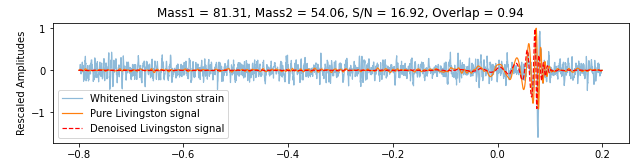

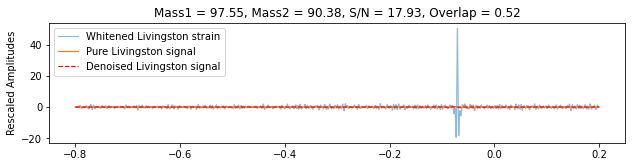

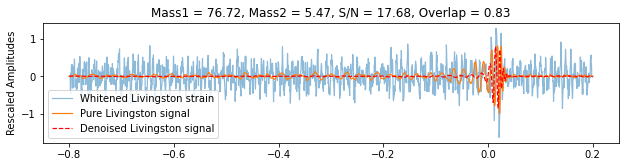

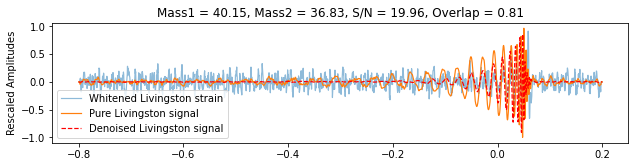

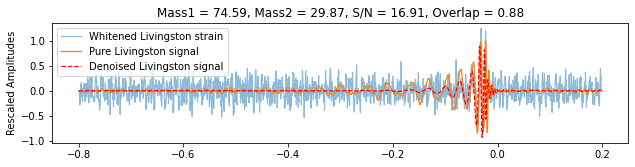

...

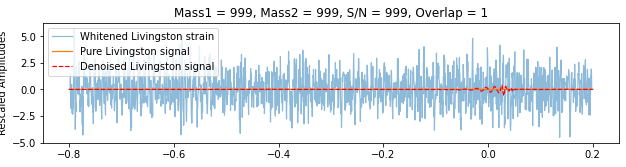

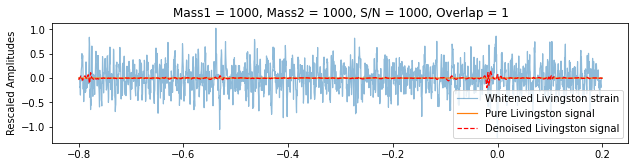

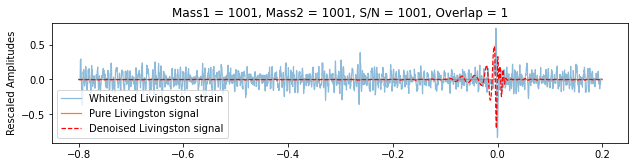

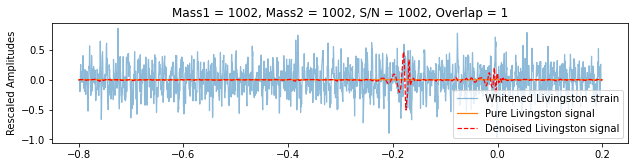

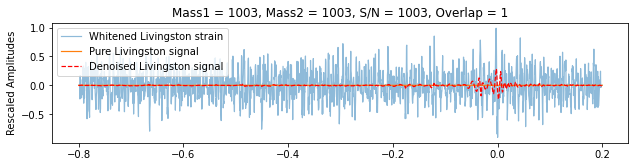

In [29]:
overlaps_10_22_33 = []

for i in range(50):
    pure_signals = np.pad(f1['injection_parameters']['l1_signal_whitened'][i].astype(np.float64), (5,5), constant_values=(0,0))   
    strain = np.pad(f1['injection_samples']['l1_strain'][i].astype(np.float64), (5,5), constant_values=(0,0))
    psd = f1['injection_parameters']['psd_noise_l1'][i].astype(np.float64)
    
    m1 = f1['injection_parameters']['mass1'][i]
    m2 = f1['injection_parameters']['mass2'][i]
    snr = f1['injection_parameters']['l1_snr'][i]*f1['injection_parameters']['scale_factor'][i]
    
    overlaps_10_22_33.append(plot_reconstructed(decoded_signals[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr, psd))


for i in range(5):
    
    pure_signals = np.pad(f1['noise_parameters']['l1_signal_whitened'][i].astype(np.float64), (5,5), constant_values=(0,0))     
    strain = np.pad(f1['noise_samples']['l1_strain'][i].astype(np.float64), (5,5), constant_values=(0,0))
    
    m1 = 999 + i
    m2 = 999 + i
    snr = 999 + i
        
    plot_reconstructed(decoded_signals_pure_noise[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr, psd)
    

# (l,m) = (2,2), (2,1)

In [36]:
f1 = h5py.File('/fred/oz016/Chayan/samplegen_old/output/O3b_test_IMRPhenomXPHM_SNR-20to30_lm_22_21.hdf', 'r')

strain = f1['injection_samples']['l1_strain'][()]
noise = f1['noise_samples']['l1_strain'][()]

pure_signal = f1['injection_parameters']['l1_signal_whitened'][()]
pure_noise = f1['noise_parameters']['l1_signal_whitened'][()]

strain, maximum, minimum = _preprocess_data(strain, 25, 2048)
strain = np.array(strain)
strain.shape

noise, maximum, minimum = _preprocess_data(noise, 5, 2048)
noise = np.array(noise)
noise.shape

X_test_strain = reshape_sequences(25, strain)
X_test_noise = reshape_sequences(5, noise)

X_test_pure_signal = reshape_sequences(25, pure_signal)
X_test_pure_noise = reshape_sequences(5, pure_noise)

# Reshape arrays to fit into Keras model
X_test_strain = X_test_strain[:,:,:,None]
X_test_strain = X_test_strain.astype("float32")

X_test_noise = X_test_noise[:,:,:,None]
X_test_noise = X_test_noise.astype("float32")

X_test_pure_signal = X_test_pure_signal[:,:,:,None]
X_test_pure_signal = X_test_pure_signal.astype("float32")

X_test_pure_noise = X_test_pure_noise[:,:,:,None]
X_test_pure_noise = X_test_pure_noise.astype("float32")


In [37]:
decoded_signals = model.predict(X_test_strain, batch_size=25)
decoded_signals_pure_noise = model.predict(X_test_noise, batch_size=25)


<ipython-input-13-f5335e0d8b93>:35: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(10,5))


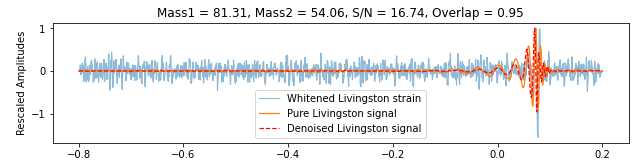

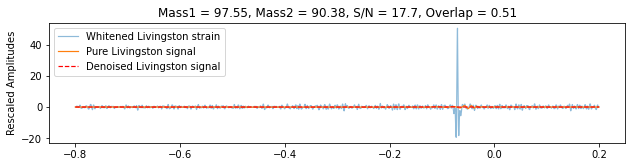

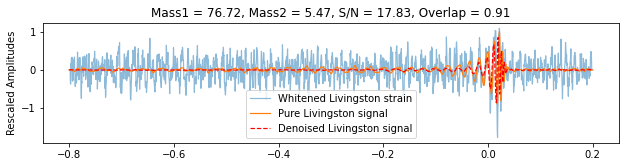

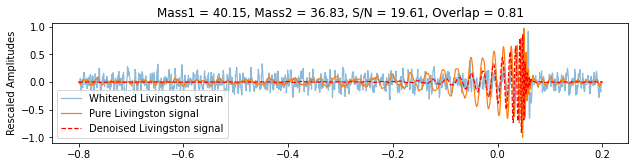

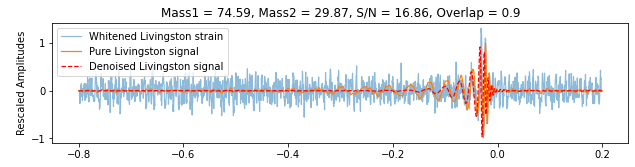

...

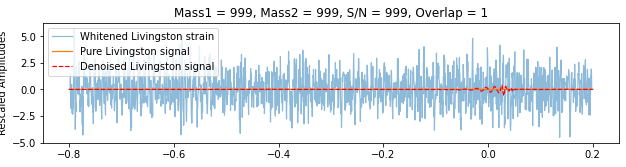

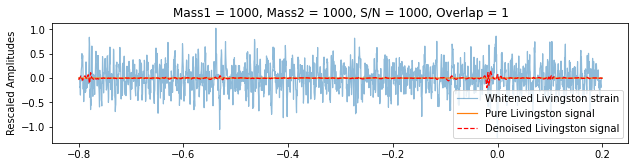

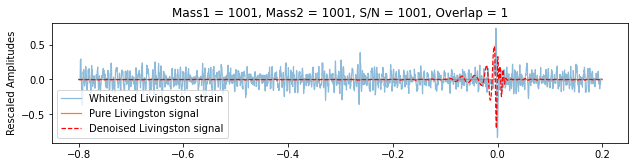

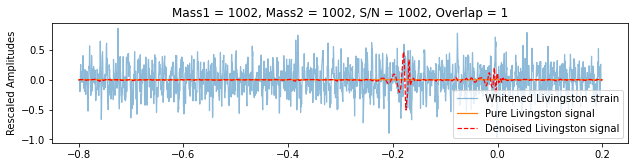

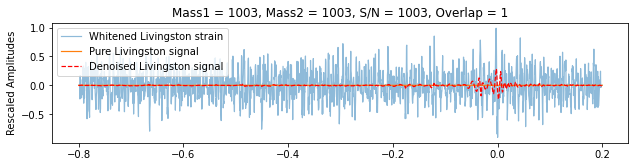

In [38]:
overlaps_10_22_21 = []

for i in range(25):
    pure_signals = np.pad(f1['injection_parameters']['l1_signal_whitened'][i].astype(np.float64), (5,5), constant_values=(0,0))   
    strain = np.pad(f1['injection_samples']['l1_strain'][i].astype(np.float64), (5,5), constant_values=(0,0))
    psd = f1['injection_parameters']['psd_noise_l1'][i].astype(np.float64)
    
    m1 = f1['injection_parameters']['mass1'][i]
    m2 = f1['injection_parameters']['mass2'][i]
    snr = f1['injection_parameters']['l1_snr'][i]*f1['injection_parameters']['scale_factor'][i]
    
    overlaps_10_22_21.append(plot_reconstructed(decoded_signals[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr, psd))


for i in range(5):
    
    pure_signals = np.pad(f1['noise_parameters']['l1_signal_whitened'][i].astype(np.float64), (5,5), constant_values=(0,0))     
    strain = np.pad(f1['noise_samples']['l1_strain'][i].astype(np.float64), (5,5), constant_values=(0,0))
    
    m1 = 999 + i
    m2 = 999 + i
    snr = 999 + i
        
    plot_reconstructed(decoded_signals_pure_noise[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr, psd)
    

# (l,m) = (2,2), (3,2)

In [40]:
f1 = h5py.File('/fred/oz016/Chayan/samplegen_old/output/O3b_test_IMRPhenomXPHM_SNR-20to30_lm_22_32.hdf', 'r')

strain = f1['injection_samples']['l1_strain'][()]
noise = f1['noise_samples']['l1_strain'][()]

pure_signal = f1['injection_parameters']['l1_signal_whitened'][()]
pure_noise = f1['noise_parameters']['l1_signal_whitened'][()]

strain, maximum, minimum = _preprocess_data(strain, 25, 2048)
strain = np.array(strain)
strain.shape

noise, maximum, minimum = _preprocess_data(noise, 5, 2048)
noise = np.array(noise)
noise.shape

X_test_strain = reshape_sequences(25, strain)
X_test_noise = reshape_sequences(5, noise)

X_test_pure_signal = reshape_sequences(25, pure_signal)
X_test_pure_noise = reshape_sequences(5, pure_noise)

# Reshape arrays to fit into Keras model
X_test_strain = X_test_strain[:,:,:,None]
X_test_strain = X_test_strain.astype("float32")

X_test_noise = X_test_noise[:,:,:,None]
X_test_noise = X_test_noise.astype("float32")

X_test_pure_signal = X_test_pure_signal[:,:,:,None]
X_test_pure_signal = X_test_pure_signal.astype("float32")

X_test_pure_noise = X_test_pure_noise[:,:,:,None]
X_test_pure_noise = X_test_pure_noise.astype("float32")


In [41]:
decoded_signals = model.predict(X_test_strain, batch_size=25)
decoded_signals_pure_noise = model.predict(X_test_noise, batch_size=25)


<ipython-input-13-f5335e0d8b93>:35: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(10,5))


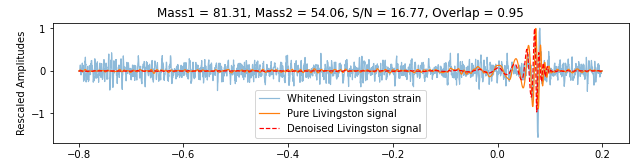

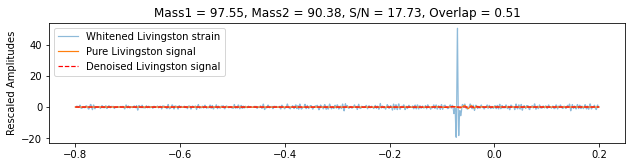

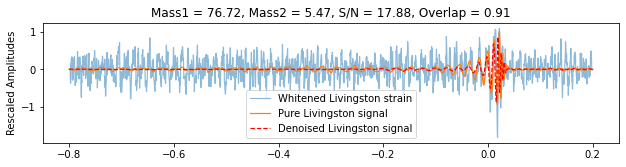

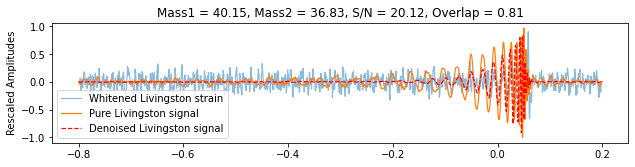

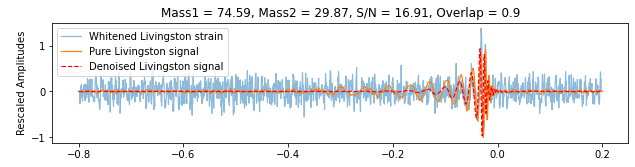

...

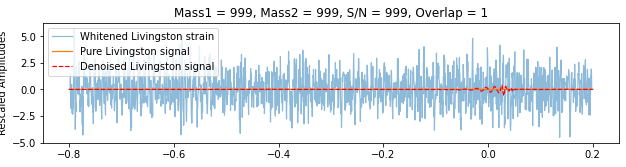

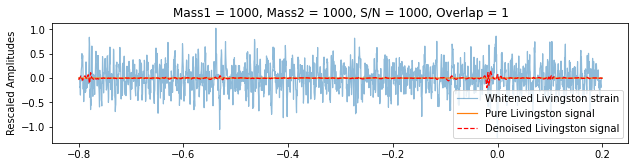

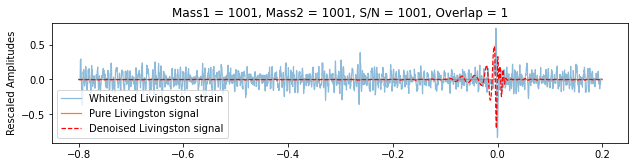

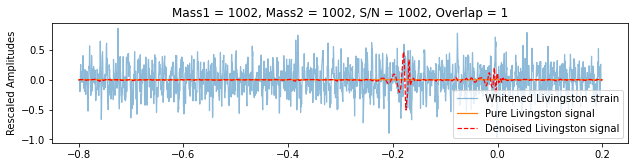

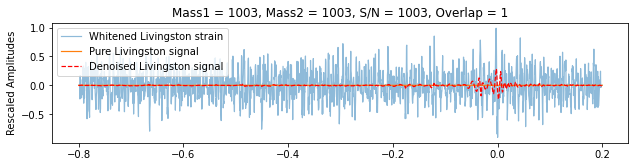

In [42]:
overlaps_10_22_32 = []

for i in range(25):
    pure_signals = np.pad(f1['injection_parameters']['l1_signal_whitened'][i].astype(np.float64), (5,5), constant_values=(0,0))   
    strain = np.pad(f1['injection_samples']['l1_strain'][i].astype(np.float64), (5,5), constant_values=(0,0))
    psd = f1['injection_parameters']['psd_noise_l1'][i].astype(np.float64)
    
    m1 = f1['injection_parameters']['mass1'][i]
    m2 = f1['injection_parameters']['mass2'][i]
    snr = f1['injection_parameters']['l1_snr'][i]*f1['injection_parameters']['scale_factor'][i]
    
    overlaps_10_22_32.append(plot_reconstructed(decoded_signals[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr, psd))


for i in range(5):
    
    pure_signals = np.pad(f1['noise_parameters']['l1_signal_whitened'][i].astype(np.float64), (5,5), constant_values=(0,0))     
    strain = np.pad(f1['noise_samples']['l1_strain'][i].astype(np.float64), (5,5), constant_values=(0,0))
    
    m1 = 999 + i
    m2 = 999 + i
    snr = 999 + i
        
    plot_reconstructed(decoded_signals_pure_noise[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr, psd)
    

# (l,m) = (2,2), (4,4)

In [43]:
f1 = h5py.File('/fred/oz016/Chayan/samplegen_old/output/O3b_test_IMRPhenomXPHM_SNR-20to30_lm_22_44.hdf', 'r')

strain = f1['injection_samples']['l1_strain'][()]
noise = f1['noise_samples']['l1_strain'][()]

pure_signal = f1['injection_parameters']['l1_signal_whitened'][()]
pure_noise = f1['noise_parameters']['l1_signal_whitened'][()]

strain, maximum, minimum = _preprocess_data(strain, 25, 2048)
strain = np.array(strain)
strain.shape

noise, maximum, minimum = _preprocess_data(noise, 5, 2048)
noise = np.array(noise)
noise.shape

X_test_strain = reshape_sequences(25, strain)
X_test_noise = reshape_sequences(5, noise)

X_test_pure_signal = reshape_sequences(25, pure_signal)
X_test_pure_noise = reshape_sequences(5, pure_noise)

# Reshape arrays to fit into Keras model
X_test_strain = X_test_strain[:,:,:,None]
X_test_strain = X_test_strain.astype("float32")

X_test_noise = X_test_noise[:,:,:,None]
X_test_noise = X_test_noise.astype("float32")

X_test_pure_signal = X_test_pure_signal[:,:,:,None]
X_test_pure_signal = X_test_pure_signal.astype("float32")

X_test_pure_noise = X_test_pure_noise[:,:,:,None]
X_test_pure_noise = X_test_pure_noise.astype("float32")


In [44]:
decoded_signals = model.predict(X_test_strain, batch_size=25)
decoded_signals_pure_noise = model.predict(X_test_noise, batch_size=25)


<ipython-input-13-f5335e0d8b93>:35: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(10,5))


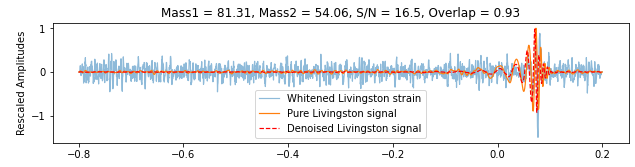

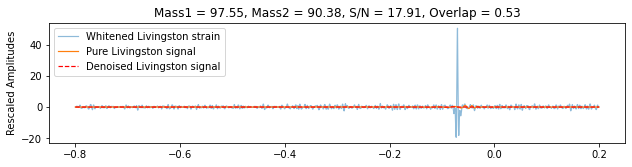

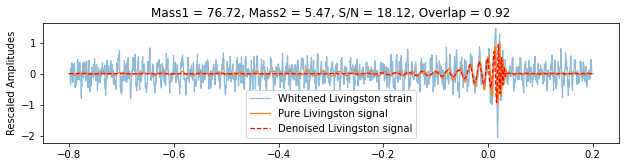

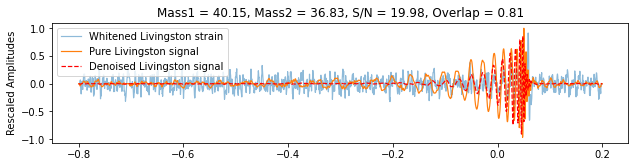

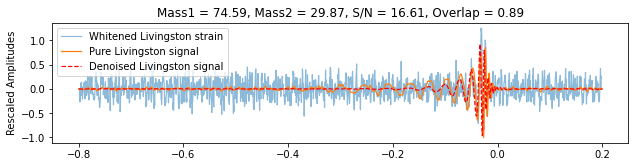

...

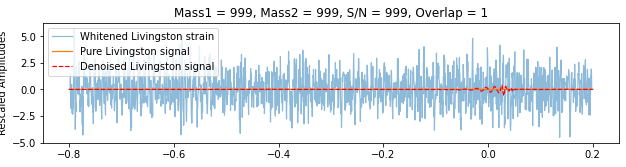

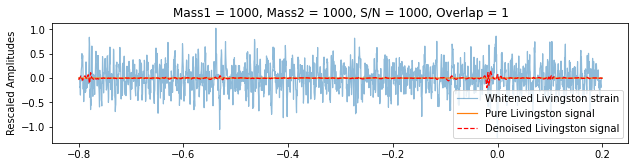

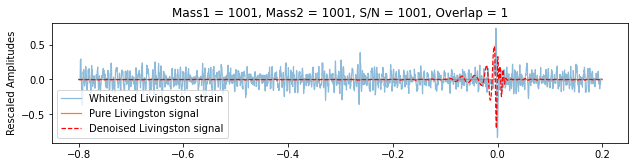

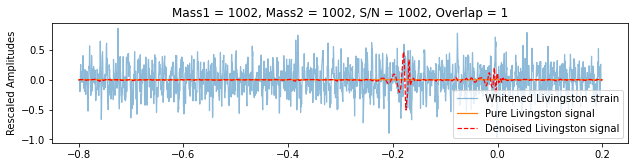

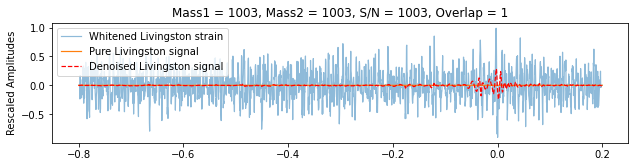

In [45]:
overlaps_10_22_44 = []

for i in range(25):
    pure_signals = np.pad(f1['injection_parameters']['l1_signal_whitened'][i].astype(np.float64), (5,5), constant_values=(0,0))   
    strain = np.pad(f1['injection_samples']['l1_strain'][i].astype(np.float64), (5,5), constant_values=(0,0))
    psd = f1['injection_parameters']['psd_noise_l1'][i].astype(np.float64)
    
    m1 = f1['injection_parameters']['mass1'][i]
    m2 = f1['injection_parameters']['mass2'][i]
    snr = f1['injection_parameters']['l1_snr'][i]*f1['injection_parameters']['scale_factor'][i]
    
    overlaps_10_22_44.append(plot_reconstructed(decoded_signals[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr, psd))


for i in range(5):
    
    pure_signals = np.pad(f1['noise_parameters']['l1_signal_whitened'][i].astype(np.float64), (5,5), constant_values=(0,0))     
    strain = np.pad(f1['noise_samples']['l1_strain'][i].astype(np.float64), (5,5), constant_values=(0,0))
    
    m1 = 999 + i
    m2 = 999 + i
    snr = 999 + i
        
    plot_reconstructed(decoded_signals_pure_noise[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr, psd)
    

# (l,m) = (2,2)

In [46]:
f1 = h5py.File('/fred/oz016/Chayan/samplegen_old/output/O3b_test_IMRPhenomXPHM_SNR-20to30_lm_22.hdf', 'r')

strain = f1['injection_samples']['l1_strain'][()]
noise = f1['noise_samples']['l1_strain'][()]

pure_signal = f1['injection_parameters']['l1_signal_whitened'][()]
pure_noise = f1['noise_parameters']['l1_signal_whitened'][()]

strain, maximum, minimum = _preprocess_data(strain, 25, 2048)
strain = np.array(strain)
strain.shape

noise, maximum, minimum = _preprocess_data(noise, 5, 2048)
noise = np.array(noise)
noise.shape

X_test_strain = reshape_sequences(25, strain)
X_test_noise = reshape_sequences(5, noise)

X_test_pure_signal = reshape_sequences(25, pure_signal)
X_test_pure_noise = reshape_sequences(5, pure_noise)

# Reshape arrays to fit into Keras model
X_test_strain = X_test_strain[:,:,:,None]
X_test_strain = X_test_strain.astype("float32")

X_test_noise = X_test_noise[:,:,:,None]
X_test_noise = X_test_noise.astype("float32")

X_test_pure_signal = X_test_pure_signal[:,:,:,None]
X_test_pure_signal = X_test_pure_signal.astype("float32")

X_test_pure_noise = X_test_pure_noise[:,:,:,None]
X_test_pure_noise = X_test_pure_noise.astype("float32")


In [47]:
decoded_signals = model.predict(X_test_strain, batch_size=25)
decoded_signals_pure_noise = model.predict(X_test_noise, batch_size=25)


<ipython-input-13-f5335e0d8b93>:35: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(10,5))


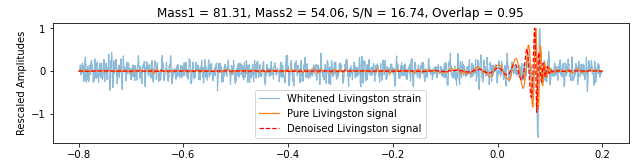

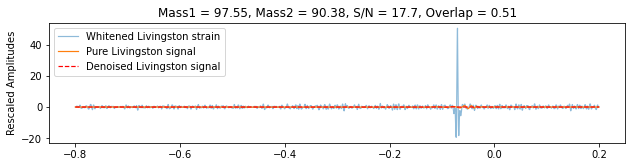

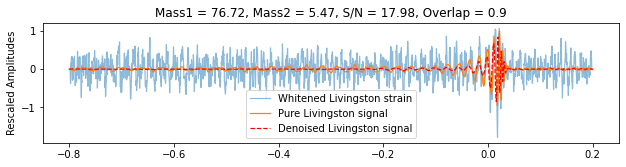

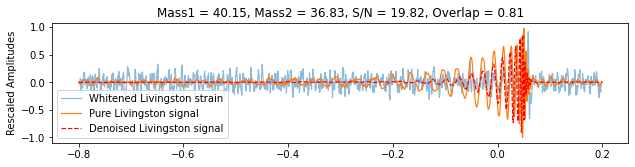

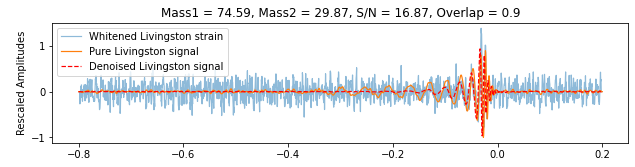

...

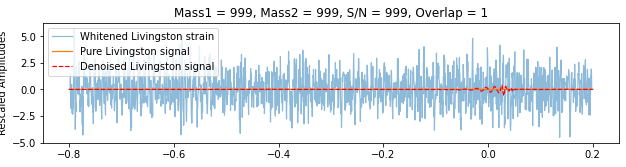

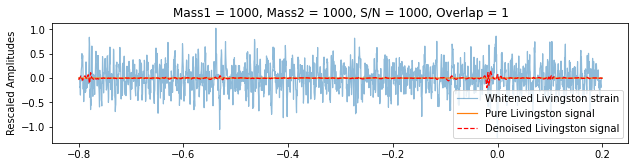

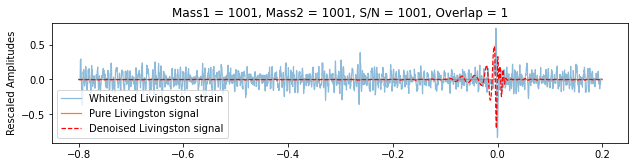

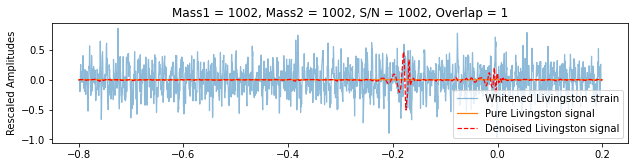

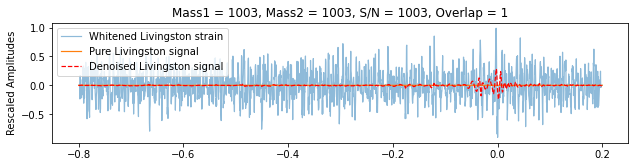

In [48]:
overlaps_10_22 = []

for i in range(25):
    pure_signals = np.pad(f1['injection_parameters']['l1_signal_whitened'][i].astype(np.float64), (5,5), constant_values=(0,0))   
    strain = np.pad(f1['injection_samples']['l1_strain'][i].astype(np.float64), (5,5), constant_values=(0,0))
    psd = f1['injection_parameters']['psd_noise_l1'][i].astype(np.float64)
    
    m1 = f1['injection_parameters']['mass1'][i]
    m2 = f1['injection_parameters']['mass2'][i]
    snr = f1['injection_parameters']['l1_snr'][i]*f1['injection_parameters']['scale_factor'][i]
    
    overlaps_10_22.append(plot_reconstructed(decoded_signals[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr, psd))


for i in range(5):
    
    pure_signals = np.pad(f1['noise_parameters']['l1_signal_whitened'][i].astype(np.float64), (5,5), constant_values=(0,0))     
    strain = np.pad(f1['noise_samples']['l1_strain'][i].astype(np.float64), (5,5), constant_values=(0,0))
    
    m1 = 999 + i
    m2 = 999 + i
    snr = 999 + i
        
    plot_reconstructed(decoded_signals_pure_noise[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr, psd)
    

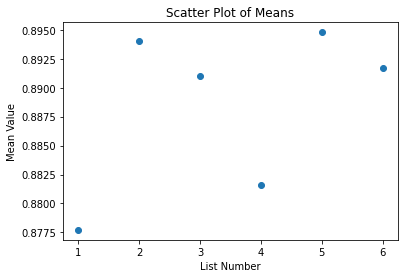

In [54]:
# Store the lists in a collection
lists = [overlaps_10_all, overlaps_10_22, overlaps_10_22_21, overlaps_10_22_33, overlaps_10_22_32, overlaps_10_22_44]

# Calculate means using a loop
means = [sum(lst) / len(lst) for lst in lists]

# Prepare data for scatter plot
indices = range(1, len(lists) + 1)  # Generate indices based on the number of lists

# Create scatter plot
plt.scatter(indices, means)
plt.xlabel('List Number')
plt.ylabel('Mean Value')
plt.title('Scatter Plot of Means')
plt.xticks(indices)  # Set x-axis ticks to match list numbers
plt.show()


ValueError: The number of FixedLocator locations (6), usually from a call to set_ticks, does not match the number of ticklabels (4).

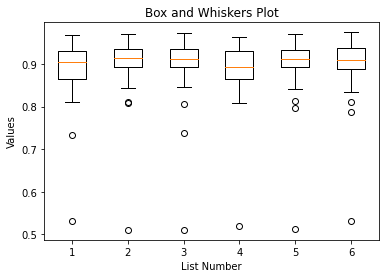

In [56]:
# Create a figure with increased width
plt.figure(figsize=(10, 6))  # Adjust the width and height as needed

plt.boxplot(lists)
plt.xlabel('List Number')
plt.ylabel('Values')
plt.title('Box and Whiskers Plot')
plt.xticks(range(1, len(lists) + 1), ['all', '(2,2)', '(2,2),(2,1)', '(2,2),(3,3)', '(2,2),(3,2)', '(2,2),(4,4)'])
plt.show()


In [32]:
f1 = h5py.File('/fred/oz016/Chayan/BBH_sample_files/O3b_IMBH_train_IMRPhenomXPHM_signal_noise_SNR-8to30.hdf', 'r')


In [34]:
f1['noise_samples']['l1_strain'][()].shape

(20000, 2048)

In [9]:
f1 = h5py.File('/fred/oz016/Chayan/BBH_sample_files/O3b_IMBH_train_IMRPhenomXPHM_signal_noise.hdf', 'r')

f1['injection_parameters']['mass1'][()].min()


5.0023518461840935

In [10]:
import h5py

f1 = h5py.File('/fred/oz016/Chayan/samplegen_old/output/O3b_IMBH_test_SEOBNRv4PHM_all.hdf', 'r')

f1['injection_parameters']['mass1'][()].max()


33.36287858931622

In [ ]:
import h5py

f1 = h5py.FIle('/fred/oz016/Chayan/BBH_sample_files/O3b_IMBH_test_IMRPhenomXPHM_signal_noise_30Hz.hdf', 'r')

f1['injection_samples']